<a href="https://colab.research.google.com/github/diff94/STM_shorttext/blob/main/R_STM_BTM_neat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# R_google

In [ ]:
install.packages("googledrive")
library("googledrive")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:

# Check if is running in Colab and redefine is_interactive()
if (file.exists("/usr/local/lib/python3.7/dist-packages/google/colab/_ipython.py")) {
  install.packages("R.utils")
  library("R.utils")
  library("httr")
  my_check <- function() {return(TRUE)}
  reassignInPackage("is_interactive", pkgName = "httr", my_check) 
  options(rlang_interactive=TRUE)
}

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘R.oo’, ‘R.methodsS3’


Loading required package: R.oo

Loading required package: R.methodsS3

R.methodsS3 v1.8.2 (2022-06-13 22:00:14 UTC) successfully loaded. See ?R.methodsS3 for help.

R.oo v1.25.0 (2022-06-12 02:20:02 UTC) successfully loaded. See ?R.oo for help.


Attaching package: ‘R.oo’


The following object is masked from ‘package:R.methodsS3’:

    throw


The following objects are masked from ‘package:methods’:

    getClasses, getMethods


The following objects are masked from ‘package:base’:

    attach, detach, load, save


R.utils v2.12.0 (2022-06-28 03:20:05 UTC) successfully loaded. See ?R.utils for help.


Attaching package: ‘R.utils’


The following object is masked from ‘package:utils’:

    timestamp


The following objects are masked from ‘package:base’:

    cat, commandArgs, getOption, isOpen, nullfile, parse, warnings




In [ ]:

# If ts not available we need to install . put other packages if you need.
packages <- c("googledrive", "googlesheets4")
if (length(setdiff(packages, rownames(installed.packages()))) > 0) {
  install.packages(setdiff(packages, rownames(installed.packages())))  
}

In [ ]:

library("googledrive")
library("googlesheets4")


Attaching package: ‘googlesheets4’


The following objects are masked from ‘package:googledrive’:

    request_generate, request_make




In [ ]:

# call authentication forcing interactive login and save in cache. 
drive_auth(use_oob = TRUE, cache = TRUE)



Please point your browser to the following url: 

https://accounts.google.com/o/oauth2/v2/auth?client_id=603366585132-dpeg5tt0et3go5of2374d83ifevk5086.apps.googleusercontent.com&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fuserinfo.email&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&response_type=code



Enter authorization code: 4/1ARtbsJp8LPLDgT10Ctg_mDkVblRVnwa64rL49mLZUpNilLhpk4wFsVYoWQ8


# load & pre-process data 

In [ ]:

system("ls", TRUE)

[1] "sample_data"

In [ ]:



#tsaidf_nona_seg_norepeat.csv
#https://drive.google.com/file/d/1BeEZgMV6lmtbjGdnAhGA9aie0Mmd_qVT/view?usp=sharing
system("gdown --id 1BeEZgMV6lmtbjGdnAhGA9aie0Mmd_qVT")

#chendf_nona_seg_norepeat.csv
#https://drive.google.com/file/d/1--Ji6EDympBIvcylTm6a1IsvJPNiI_Q3/view?usp=sharing
system("gdown --id 1--Ji6EDympBIvcylTm6a1IsvJPNiI_Q3")




In [ ]:
tsaidoc = readr::read_csv("tsaidf_nona_seg_norepeat.csv")
chendoc = readr::read_csv("chendf_nona_seg_norepeat.csv")

New names:
• `` -> `...1`
Rows: 306 Columns: 12
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (10): title, lyricist, composer, lyrics, singer, clean, sen_text, text, ...
dbl  (2): ...1, length

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
New names:
• `` -> `...1`
Rows: 122 Columns: 12
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (10): title, lyricist, composer, lyrics, singer, clean, sen_text, text, ...
dbl  (2): ...1, length

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [ ]:
colnames(tsaidoc) =c('doc_id','title','lyricist','composer','lyrics','singer','clean','sen_text','length','text','sen_seg_text','seg_text')
tsaidoc

doc_id,title,lyricist,composer,lyrics,singer,clean,sen_text,length,text,sen_seg_text,seg_text
<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
0,我是誰,梁錦興 / Jony J,MOURICE / KINGMING,作詞：梁錦興 / Jony J 作曲：MOURICE / KINGMING 習慣了黑的深邃 再野 也無畏 等星墜的餘輝 照亮誰 流放者的同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我早就習慣獨自站在山頂眺望 不需要聲勢浩蕩 路在白天走靠太陽夜裡靠我目光照亮 除了麻木的孤獨感 會讓我輸得慘 我還沒碰到什麼其它讓我覺得真的難 就算逆著風 目光堅定氣勢洶 我告訴自己憑著感覺一直沖 就是在創造歷史中 翻高山 走峭壁 我獨自驚天動地 沒有目的 沒顧忌 才會讓我更加用力 沒遇見你我是誰 沒有你的我是誰 沒有你 無所謂 我是誰 習慣了黑的深邃 再野也無畏 看星墜的餘輝照亮誰 流放者等同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我在漫無目的之中虛度 又沒人催促 無家可歸的漂流客在妄想找到歸宿 早就沒了目的地像只盤旋的孤雁 就在我快要放棄之前 你突然出現 帶給我光亮 讓我在無窮盡的漆黑裡面找到方向 不會再猶豫 不再四處張望 你拿走我的在乎我的所有注意力 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 沒有你的我是誰 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 冷漠是盔甲裡的人強忍的傷悲 一滴淚就能被摧毀 (Rap : 你拿走我的在乎我的所有注意力) 拒絕向宿命妥協因為心有所歸 是你的 我不屬於誰 (Rap : 但讓我知道我是誰也給我一個目的地) 沒遇見你我是誰 (Rap : 你拿走我的在乎我的所有注意力) 沒有你的我是誰 (Rap : 但讓我知道我是誰也給我一個目的地) 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 (Rap : 你拿走我的在乎我的所有注意力) 瞳孔裡不再是黑白灰 (Rap : 但讓我知道我是誰也給我一個目的地) 你知道 我是誰,tsai,： ： 習慣了黑的深邃 再野 也無畏 等星墜的餘輝 照亮誰 流放者的同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我早就習慣獨自站在山頂眺望 不需要聲勢浩蕩 路在白天走靠太陽夜裡靠我目光照亮 除了麻木的孤獨感 會讓我輸得慘 我還沒碰到什麼其它讓我覺得真的難 就算逆著風 目光堅定氣勢洶 我告訴自己憑著感覺一直沖 就是在創造歷史中 翻高山 走峭壁 我獨自驚天動地 沒有目的 沒顧忌 才會讓我更加用力 沒遇見你我是誰 沒有你的我是誰 沒有你 無所謂 我是誰 習慣了黑的深邃 再野也無畏 看星墜的餘輝照亮誰 流放者等同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我在漫無目的之中虛度 又沒人催促 無家可歸的漂流客在妄想找到歸宿 早就沒了目的地像只盤旋的孤雁 就在我快要放棄之前 你突然出現 帶給我光亮 讓我在無窮盡的漆黑裡面找到方向 不會再猶豫 不再四處張望 你拿走我的在乎我的所有注意力 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 沒有你的我是誰 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 冷漠是盔甲裡的人強忍的傷悲 一滴淚就能被摧毀 (Rap : 你拿走我的在乎我的所有注意力) 拒絕向宿命妥協因為心有所歸 是你的 我不屬於誰 (Rap : 但讓我知道我是誰也給我一個目的地) 沒遇見你我是誰 (Rap : 你拿走我的在乎我的所有注意力) 沒有你的我是誰 (Rap : 但讓我知道我是誰也給我一個目的地) 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 (Rap : 你拿走我的在乎我的所有注意力) 瞳孔裡不再是黑白灰 (Rap : 但讓我知道我是誰也給我一個目的地) 你知道 我是誰,習慣了黑的深邃 再野 也無畏 等星墜的餘輝 照亮誰 流放者的同類 藏著寂寞在防衛 但溫柔總是無堅不摧 我早就習慣獨自站在山頂眺望 不需要聲勢浩蕩 路在白天走靠太陽夜裡靠我目光照亮 除了麻木的孤獨感 會讓我輸得慘 我還沒碰到什麼其它讓我覺得真的難 就算逆著風 目光堅定氣勢洶 我告訴自己憑著感覺一直沖 就是在創造歷史中 翻高山 走峭壁 我獨自驚天動地 沒有目的 沒顧忌 才會讓我更加用力 沒遇見你我是誰 沒有你的我是誰 沒有你 無所謂 我是誰 習慣了黑的深邃 再野也無畏 看星墜的餘輝照亮誰 流放者等同類 藏著寂寞在防衛 但溫柔總是無堅不摧 我在漫無目的之中虛度 又沒人催促 無家可歸的漂流客在妄想找到歸宿 早就沒了目的地像只盤旋的孤雁 就在我快要放棄之前 你突然出現 帶給我光亮 讓我在無窮盡的漆黑裡面找到方向 不會再猶豫 不再四處張望 你拿走我的在乎我的所有注意力 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 沒有你的我是誰 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 冷漠是盔甲裡的人強忍的傷悲 一滴淚就能被摧毀 你拿走我的在乎我的所有注意力 拒絕向宿命妥協因為心有所歸 是你的 我不屬於誰 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 你拿走我的在乎我的所有注意力 沒有你的我是誰 但讓我知道我是誰也給我一個目的地 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 你拿走我的在乎我的所有注意力 瞳孔裡不再是黑白灰 但讓我知道我是誰也給我一個目的地 你知道 我是誰,643,習慣 黑 深邃 野 無畏 星墜 餘輝 照亮 誰 流放 者 同 類 藏 寂寞 防衛 溫柔 我 習慣 站 山頂 眺望 需要 聲勢 浩蕩 路 白天 走 靠 太陽 夜裡 靠 我 目光 照亮 麻木 孤獨感 讓 我 輸 慘 我 碰到 什麼 其它 讓 我 覺得 難 逆 風 目光 堅定 氣勢洶 我 告訴 自己 憑著 感覺 沖 創造 歷史 中 翻 高山 走 峭壁 我 驚天動地 沒有 目的 顧忌 讓 我 用力 遇見 你 我 誰 沒有 你 我 誰 沒有 你 我 誰 習慣 黑 深邃 野 無畏 看 星墜 餘輝 照亮 誰 流放 者 同 類 藏 寂寞 防衛 溫柔 無堅不摧 我 漫無 目的 之中 虛度 沒 人 催促 無家可歸 漂流客 妄想 找到 歸宿 沒 目的 地 盤旋 孤雁 我 放棄 之前 你 出現 帶給 我 光亮 讓 我 無窮盡 漆黑 裡面 找到 方向 猶豫 張望 你 拿走 我 在乎 我 所有 注意力 讓 我 知道 我 誰 給 我 一 個 目的地 遇見 你 我 誰 沒有 你 我 誰 懸絲 傀儡 有 溫度 體會 瞳孔 裡 黑白 灰 冷漠 盔甲 裡 人 強忍 傷悲 滴 淚 摧毀 你 拿走 我 在乎 我 所有 注意力 拒絕 宿命 妥協 心 有所 歸 你 我 屬於 誰 讓 我 知道 我 誰 給 我 一 個 目的地 遇見 你 我 誰 你 拿走 我 在乎 我 所有 注意力 沒有 你 我 誰 讓 我 知道 我 誰 給 我 一 個 目的地 懸絲 傀儡 有 溫度 體會 瞳孔 裡 灰 你 拿走 我 在乎 我 所有 注意力 瞳孔 裡 灰 讓 我 知道 我 誰 給 我 一 個 目的地 你 知道 我 誰,習慣 了 黑 的 深邃 再 野 也 無畏 等 星 墜 的 餘輝 照亮 誰 流放 者 的 同 類 藏 著 寂寞 在 防衛 但 溫柔 總是 無堅不摧 我 早 就 習慣 獨自 站 在 山頂 眺望 不 需要 聲勢 浩蕩 路 在 白天 走 靠 太陽 夜裡 靠 我 目光 照亮 除了 麻木 的 孤獨感 會 讓 我 輸 得 慘 我 還 沒 碰到 什麼 其它 讓 我 覺得 真的 難 就算 逆 著 風 目光 堅定 氣勢洶 我 告訴 自己 憑著 感覺 一直 沖 就 是 在 創造 歷史 中 翻 高山 走 峭壁 我 獨自 驚天動地 沒有 目的 沒 顧忌 才 會 讓 我 更加 用力 沒 遇見 你 我 是 誰 沒有 你 的 我 是 誰 沒有 你 無所謂 我 是 誰 習慣 了 黑 的 深邃 再 野 也 無畏 看 星墜 的 餘輝 照亮 誰 流放 者 等 同 類 藏 著 寂寞 在 防衛 但 溫柔 總是 無堅不摧 我 在 漫無 目的 之中 虛度 又 沒 人 催促 無家可歸 的 漂流客 在 妄想 找到 歸宿 早 就 沒 了 目的地 像 只 盤旋 的 孤雁 就 在 我 快要 放棄 之前 你 突然 出現 帶給 我 光亮 讓 我 在 無窮盡 的 漆黑 裡面 找到 方向 不會 再 猶豫 不再 四處 張望 你 拿走 我 的 在乎 我 的 所有 注意力 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 沒 遇見 你 我 是 誰 沒有 你 的 我 是 誰 當 懸絲 的 傀儡 有 過 溫度 的 體會 瞳孔 裡 不再 是 黑白 灰 冷漠 是 盔甲 裡 的 人 強忍 的 傷悲 一 滴 淚 就 能 被 摧毀 你 拿走 我 的 在乎 我 的 所有 注意力 拒絕 向 宿命 妥協 因為 心 有所 歸 是 你 的 我 不 屬於 誰 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 沒 遇見 你 我 是 誰 你 拿走 我 的 在乎 我 的 所有 注意力 沒有 你 的 我 是 誰 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 當 懸絲 的 傀儡 有 過 溫度 的 體會 瞳孔 裡 不再 是 黑白 灰 你 拿走 我 的 在乎 我 的 所有 注意力 瞳孔 裡 不再 是 黑白 灰 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 你 知道 我 是 誰,習慣 了 黑 的 深邃 再 野 也 無畏 等 星墜 的 餘輝 照亮 誰 流放 者

In [ ]:

colnames(chendoc) =c('doc_id','title','lyricist','composer','lyrics','singer','clean','sen_text','length','text','sen_seg_text','seg_text')
chendoc 

doc_id,title,lyricist,composer,lyrics,singer,clean,sen_text,length,text,sen_seg_text,seg_text
<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>
0,完整的我,陳綺貞、鬼卞,陳綺貞、鬼卞,作詞：陳綺貞、鬼卞 作曲：陳綺貞、鬼卞 用一頁白紙 描繪我這 滿身創傷或 美麗的模樣 讓刀子刻下 歲月一場 雕塑了此生 殘缺與陰陽 一半是 流浪的手掌 一半是 不滅的太陽 幾輩子 才懂得欣賞 越是遺憾 越是永恆 感謝還在疼痛著的地方 沒受傷 就不夠瘋狂 如果問到為何我會愛我呢 還好我是不完整的我 把自己切割成無數張破碎拼圖 被時間重組 逐漸將一路看得清楚 留給我一秒鐘 深刻的人間疾苦 再賜我一百年 紀念這數不勝數 遺失了 天真地 自由地 哭泣著 遺失了 渴望地 熱烈地 呼吸著 拾起了 快樂的 悲傷的 不去惹 卻也拾起了 向死的 向生的 不去躲 這一切該被 帶走的 就讓它 帶走吧 反正都 留不住 求不上 還沒到來的 也許會 拆散你 埋葬你 涅槃你 蛻變成 新模樣 但經歷了風雨的侵蝕 幻變的影子 就不再怕捆綁 直到被打磨堅硬成鋼 迎接所有不可知的想像 給你我寂靜的瘡<U+764D> 給我你喧嘩的槍 給你我瞬間的蒼白 給我你亙古的光 給我們絕世的荒唐 無法再复制的肩膀 逝去的 永遠閃亮 未來的 永遠嚮往 感謝還在疼痛著的地方 沒受傷 就不夠瘋狂 如果問到為何我會愛我呢 還好我是不完整的我 等待還未擁抱過的絕望 沒翅膀 也可以飛翔 如果你也一樣跌宕 又何妨 還有一個不完整的我 我 一直都是我 沉默 快活 斑駁 年輪組成我 如今的灑脫 (怎麼樣 都是我) 不朽 不朽 不朽 完整的我,chen,： ： 用一頁白紙 描繪我這 滿身創傷或 美麗的模樣 讓刀子刻下 歲月一場 雕塑了此生 殘缺與陰陽 一半是 流浪的手掌 一半是 不滅的太陽 幾輩子 才懂得欣賞 越是遺憾 越是永恆 感謝還在疼痛著的地方 沒受傷 就不夠瘋狂 如果問到為何我會愛我呢 還好我是不完整的我 把自己切割成無數張破碎拼圖 被時間重組 逐漸將一路看得清楚 留給我一秒鐘 深刻的人間疾苦 再賜我一百年 紀念這數不勝數 遺失了 天真地 自由地 哭泣著 遺失了 渴望地 熱烈地 呼吸著 拾起了 快樂的 悲傷的 不去惹 卻也拾起了 向死的 向生的 不去躲 這一切該被 帶走的 就讓它 帶走吧 反正都 留不住 求不上 還沒到來的 也許會 拆散你 埋葬你 涅槃你 蛻變成 新模樣 但經歷了風雨的侵蝕 幻變的影子 就不再怕捆綁 直到被打磨堅硬成鋼 迎接所有不可知的想像 給你我寂靜的瘡<U+764D> 給我你喧嘩的槍 給你我瞬間的蒼白 給我你亙古的光 給我們絕世的荒唐 無法再复制的肩膀 逝去的 永遠閃亮 未來的 永遠嚮往 感謝還在疼痛著的地方 沒受傷 就不夠瘋狂 如果問到為何我會愛我呢 還好我是不完整的我 等待還未擁抱過的絕望 沒翅膀 也可以飛翔 如果你也一樣跌宕 又何妨 還有一個不完整的我 我 一直都是我 沉默 快活 斑駁 年輪組成我 如今的灑脫 (怎麼樣 都是我) 不朽 不朽 不朽 完整的我,用一頁白紙 描繪我這 滿身創傷或 美麗的模樣 讓刀子刻下 歲月一場 雕塑了此生 殘缺與陰陽 一半是 流浪的手掌 一半是 不滅的太陽 幾輩子 才懂得欣賞 越是遺憾 越是永恆 感謝還在疼痛著的地方 沒受傷 就不夠瘋狂 如果問到為何我會愛我呢 還好我是不完整的我 把自己切割成無數張破碎拼圖 被時間重組 逐漸將一路看得清楚 留給我一秒鐘 深刻的人間疾苦 再賜我一百年 紀念這數不勝數 遺失了 天真地 自由地 哭泣著 遺失了 渴望地 熱烈地 呼吸著 拾起了 快樂的 悲傷的 不去惹 卻也拾起了 向死的 向生的 不去躲 這一切該被 帶走的 就讓它 帶走吧 反正都 留不住 求不上 還沒到來的 也許會 拆散你 埋葬你 涅槃你 蛻變成 新模樣 但經歷了風雨的侵蝕 幻變的影子 就不再怕捆綁 直到被打磨堅硬成鋼 迎接所有不可知的想像 給你我寂靜的瘡 給我你喧嘩的槍 給你我瞬間的蒼白 給我你亙古的光 給我們絕世的荒唐 無法再复制的肩膀 逝去的 永遠閃亮 未來的 永遠嚮往 感謝還在疼痛著的地方 沒受傷 就不夠瘋狂 如果問到為何我會愛我呢 還好我是不完整的我 等待還未擁抱過的絕望 沒翅膀 也可以飛翔 如果你也一樣跌宕 又何妨 還有一個不完整的我 我 一直都是我 沉默 快活 斑駁 年輪組成我 如今的灑脫 怎麼樣 都是我 不朽 不朽 不朽 完整的我,565,一 頁 白紙 描繪 我 這 滿 身 創傷 美麗 模樣 讓 刀子 刻下 歲月 一 場 雕塑 此 生 殘缺 陰陽 一半 流浪 手掌 一半 滅 太陽 幾 輩子 懂得 欣賞 遺憾 永恆 感謝 疼痛 地方 受傷 瘋狂 問到 我 愛 我 我 完整 我 自己 切割成 無數 張 破碎 拼圖 時間 重組 看 清楚 留給 我 一 秒鐘 深刻 人間 疾苦 賜 我 一百 年 紀念 這 數不勝 數 遺失 天真 自由 哭泣 遺失 渴望 熱烈 呼吸 拾起 快樂 悲傷 惹 拾起 死 向 生 躲 這 一切 帶走 讓 它 帶走 留 住 求 上 到來 拆散 你 埋葬 你 涅槃 你 蛻變成 新 模樣 經歷 風雨 侵蝕 幻變 影子 怕 捆綁 打磨 堅硬 成 鋼 迎接 所有 知 想像 給 你 我 寂靜 瘡 給 我 你 喧嘩 槍 你 我 瞬間 蒼白 給 我 你 亙古 光 給 我們 荒唐 复制 肩膀 逝去 閃亮 未來 嚮往 感謝 疼痛 地方 受傷 瘋狂 問到 我 愛 我 我 完整 我 等待 擁抱 絕望 沒 翅膀 飛翔 你 一樣 跌宕 有 一 個 完整 我 我 我 沉默 快活 斑駁 年輪 組成 我 如今 灑脫 怎麼樣 我 不朽 不朽 不朽 完整 我,用 一 頁 白紙 描繪 我 這 滿 身 創傷 或 美麗 的 模樣 讓 刀子 刻下 歲月 一 場 雕塑 了 此 生 殘缺 與 陰陽 一半 是 流浪 的 手掌 一半 是 不 滅 的 太陽 幾 輩子 才 懂得 欣賞 越 是 遺憾 越 是 永恆 感謝 還 在 疼痛 著 的 地方 沒 受傷 就 不 夠 瘋狂 如果 問到 為何 我 會 愛 我 呢 還好 我 是 不 完整 的 我 把 自己 切割成 無數 張 破碎 拼圖 被 時間 重組 逐漸 將 一路 看 得 清楚 留給 我 一 秒鐘 深刻 的 人間 疾苦 再 賜 我 一百 年 紀念 這 數 不勝 數 遺失 了 天真 地 自由 地 哭泣 著 遺失 了 渴望 地 熱烈 地 呼吸 著 拾起 了 快樂 的 悲傷 的 不 去 惹 卻 也 拾起 了 向 死 的 向 生 的 不 去 躲 這 一切 該 被 帶走 的 就 讓 它 帶走 吧 反正 都 留 不 住 求 不 上 還 沒 到來 的 也許 會 拆散 你 埋葬 你 涅槃 你 蛻變成 新 模樣 但 經歷 了 風雨 的 侵蝕 幻變 的 影子 就 不再 怕 捆綁 直到 被 打磨 堅硬 成 鋼 迎接 所有 不可 知 的 想像 給 你我 寂靜 的 瘡 給 我 你 喧嘩 的 槍 給 你我 瞬間 的 蒼白 給 我 你 亙古 的 光 給 我們 絕世 的 荒唐 無法 再 复制 的 肩膀 逝去 的 永遠 閃亮 未來 的 永遠 嚮往 感謝 還 在 疼痛 著 的 地方 沒 受傷 就 不 夠 瘋狂 如果 問到 為何 我 會 愛 我 呢 還好 我 是 不 完整 的 我 等待 還 未 擁抱 過 的 絕望 沒 翅膀 也 可以 飛翔 如果 你 也 一樣 跌宕 又 何妨 還 有 一 個 不 完整 的 我 我 一直 都 是 我 沉默 快活 斑駁 年輪 組成 我 如今 的 灑脫 怎麼樣 都 是 我 不朽 不朽 不朽 完整 的 我,用 一 頁 白紙 描繪 我 這 滿 身 創傷 或 美麗 的 模樣 讓 刀子 刻下 歲月 一 場 雕塑 了 此 生 殘缺 與 陰陽 一半 是 流浪 的 手掌 一半 是 不 滅 的 太陽 幾 輩子 才 懂得 欣賞 越 是 遺憾 越 是 永恆 感謝 還 在 疼痛 著 的 地方 沒 受傷 就 不 夠 瘋狂 如果 問到 為何 我 會 愛 我 呢 還好 我 是 不 完整 的 我 把 自己 切割成 無數 張 破碎 拼圖 被 時間 重組 逐漸 將 一路 看 得 清楚 留給 我 一 秒鐘 深刻 的 人間 疾苦 再 賜 我 一百 年 紀念 這 數不勝 數 遺失 了 天真 地 自由 地 哭泣 著 遺失 了 渴望 地 熱烈 地 呼吸 著 拾起 了 快樂 的 悲傷 的 不 去 惹 卻 也 拾起 了 向 死 的 向 生 的 不 去 躲 這 一切 該 被 帶走 的 就 讓 它 帶走 吧 反正 都 留 不 住 求 不 上 還 沒 到來 的 也許 會 拆散 你 埋葬 你 涅槃 你 蛻變成 新 模樣 但 經歷 了 風雨 的 侵蝕 幻變 的 影子 就 不再 怕 捆綁 直到 被 打磨 堅硬 成 鋼 迎接 所有 不可 知 的 想像 給 你我 寂靜 的 瘡 給 我 你 喧嘩 的 槍 給 你 我 瞬間 的 蒼白 給 我 你 亙古 的 光 給 我們 絕世 的 荒唐 無法 再 复制 的 肩膀 逝去 的 永遠 閃亮 未來 的 永遠 嚮往 感謝 還 在 疼痛 著 的 地方 沒 受傷 就 不 夠 瘋狂 如果 問到 為何 我 會 愛 我 呢 還好 我 是 不 完整 的 我 等待 還 未 擁抱 過 的 絕望 沒 翅膀 也 可以 飛翔 如果 你 也 一樣 跌宕 又 何妨 還 有 一 個 不 完整 的 我 我 一直 都 是 我 沉默 快活 斑駁 年輪 組

In [ ]:
tcdf = rbind(tsaidoc,chendoc) 
colnames(tcdf) = c('origin_doc_id','title','lyricist','composer','lyrics','singer','clean','sen_text','length','text','sen_seg_text','seg_text')


In [ ]:
tcdf = tibble::rowid_to_column(tcdf, "doc_id") #有一個統一的ID
tcdf['DOC_ID'] = tcdf['doc_id']
tcdf

doc_id,origin_doc_id,title,lyricist,composer,lyrics,singer,clean,sen_text,length,text,sen_seg_text,seg_text,DOC_ID
<int>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<int>
1,0,我是誰,梁錦興 / Jony J,MOURICE / KINGMING,作詞：梁錦興 / Jony J 作曲：MOURICE / KINGMING 習慣了黑的深邃 再野 也無畏 等星墜的餘輝 照亮誰 流放者的同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我早就習慣獨自站在山頂眺望 不需要聲勢浩蕩 路在白天走靠太陽夜裡靠我目光照亮 除了麻木的孤獨感 會讓我輸得慘 我還沒碰到什麼其它讓我覺得真的難 就算逆著風 目光堅定氣勢洶 我告訴自己憑著感覺一直沖 就是在創造歷史中 翻高山 走峭壁 我獨自驚天動地 沒有目的 沒顧忌 才會讓我更加用力 沒遇見你我是誰 沒有你的我是誰 沒有你 無所謂 我是誰 習慣了黑的深邃 再野也無畏 看星墜的餘輝照亮誰 流放者等同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我在漫無目的之中虛度 又沒人催促 無家可歸的漂流客在妄想找到歸宿 早就沒了目的地像只盤旋的孤雁 就在我快要放棄之前 你突然出現 帶給我光亮 讓我在無窮盡的漆黑裡面找到方向 不會再猶豫 不再四處張望 你拿走我的在乎我的所有注意力 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 沒有你的我是誰 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 冷漠是盔甲裡的人強忍的傷悲 一滴淚就能被摧毀 (Rap : 你拿走我的在乎我的所有注意力) 拒絕向宿命妥協因為心有所歸 是你的 我不屬於誰 (Rap : 但讓我知道我是誰也給我一個目的地) 沒遇見你我是誰 (Rap : 你拿走我的在乎我的所有注意力) 沒有你的我是誰 (Rap : 但讓我知道我是誰也給我一個目的地) 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 (Rap : 你拿走我的在乎我的所有注意力) 瞳孔裡不再是黑白灰 (Rap : 但讓我知道我是誰也給我一個目的地) 你知道 我是誰,tsai,： ： 習慣了黑的深邃 再野 也無畏 等星墜的餘輝 照亮誰 流放者的同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我早就習慣獨自站在山頂眺望 不需要聲勢浩蕩 路在白天走靠太陽夜裡靠我目光照亮 除了麻木的孤獨感 會讓我輸得慘 我還沒碰到什麼其它讓我覺得真的難 就算逆著風 目光堅定氣勢洶 我告訴自己憑著感覺一直沖 就是在創造歷史中 翻高山 走峭壁 我獨自驚天動地 沒有目的 沒顧忌 才會讓我更加用力 沒遇見你我是誰 沒有你的我是誰 沒有你 無所謂 我是誰 習慣了黑的深邃 再野也無畏 看星墜的餘輝照亮誰 流放者等同類 藏著寂寞在防衛 但溫柔總是無堅不摧 Rap： 我在漫無目的之中虛度 又沒人催促 無家可歸的漂流客在妄想找到歸宿 早就沒了目的地像只盤旋的孤雁 就在我快要放棄之前 你突然出現 帶給我光亮 讓我在無窮盡的漆黑裡面找到方向 不會再猶豫 不再四處張望 你拿走我的在乎我的所有注意力 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 沒有你的我是誰 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 冷漠是盔甲裡的人強忍的傷悲 一滴淚就能被摧毀 (Rap : 你拿走我的在乎我的所有注意力) 拒絕向宿命妥協因為心有所歸 是你的 我不屬於誰 (Rap : 但讓我知道我是誰也給我一個目的地) 沒遇見你我是誰 (Rap : 你拿走我的在乎我的所有注意力) 沒有你的我是誰 (Rap : 但讓我知道我是誰也給我一個目的地) 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 (Rap : 你拿走我的在乎我的所有注意力) 瞳孔裡不再是黑白灰 (Rap : 但讓我知道我是誰也給我一個目的地) 你知道 我是誰,習慣了黑的深邃 再野 也無畏 等星墜的餘輝 照亮誰 流放者的同類 藏著寂寞在防衛 但溫柔總是無堅不摧 我早就習慣獨自站在山頂眺望 不需要聲勢浩蕩 路在白天走靠太陽夜裡靠我目光照亮 除了麻木的孤獨感 會讓我輸得慘 我還沒碰到什麼其它讓我覺得真的難 就算逆著風 目光堅定氣勢洶 我告訴自己憑著感覺一直沖 就是在創造歷史中 翻高山 走峭壁 我獨自驚天動地 沒有目的 沒顧忌 才會讓我更加用力 沒遇見你我是誰 沒有你的我是誰 沒有你 無所謂 我是誰 習慣了黑的深邃 再野也無畏 看星墜的餘輝照亮誰 流放者等同類 藏著寂寞在防衛 但溫柔總是無堅不摧 我在漫無目的之中虛度 又沒人催促 無家可歸的漂流客在妄想找到歸宿 早就沒了目的地像只盤旋的孤雁 就在我快要放棄之前 你突然出現 帶給我光亮 讓我在無窮盡的漆黑裡面找到方向 不會再猶豫 不再四處張望 你拿走我的在乎我的所有注意力 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 沒有你的我是誰 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 冷漠是盔甲裡的人強忍的傷悲 一滴淚就能被摧毀 你拿走我的在乎我的所有注意力 拒絕向宿命妥協因為心有所歸 是你的 我不屬於誰 但讓我知道我是誰也給我一個目的地 沒遇見你我是誰 你拿走我的在乎我的所有注意力 沒有你的我是誰 但讓我知道我是誰也給我一個目的地 當懸絲的傀儡 有過溫度的體會 瞳孔裡不再是黑白灰 你拿走我的在乎我的所有注意力 瞳孔裡不再是黑白灰 但讓我知道我是誰也給我一個目的地 你知道 我是誰,643,習慣 黑 深邃 野 無畏 星墜 餘輝 照亮 誰 流放 者 同 類 藏 寂寞 防衛 溫柔 我 習慣 站 山頂 眺望 需要 聲勢 浩蕩 路 白天 走 靠 太陽 夜裡 靠 我 目光 照亮 麻木 孤獨感 讓 我 輸 慘 我 碰到 什麼 其它 讓 我 覺得 難 逆 風 目光 堅定 氣勢洶 我 告訴 自己 憑著 感覺 沖 創造 歷史 中 翻 高山 走 峭壁 我 驚天動地 沒有 目的 顧忌 讓 我 用力 遇見 你 我 誰 沒有 你 我 誰 沒有 你 我 誰 習慣 黑 深邃 野 無畏 看 星墜 餘輝 照亮 誰 流放 者 同 類 藏 寂寞 防衛 溫柔 無堅不摧 我 漫無 目的 之中 虛度 沒 人 催促 無家可歸 漂流客 妄想 找到 歸宿 沒 目的 地 盤旋 孤雁 我 放棄 之前 你 出現 帶給 我 光亮 讓 我 無窮盡 漆黑 裡面 找到 方向 猶豫 張望 你 拿走 我 在乎 我 所有 注意力 讓 我 知道 我 誰 給 我 一 個 目的地 遇見 你 我 誰 沒有 你 我 誰 懸絲 傀儡 有 溫度 體會 瞳孔 裡 黑白 灰 冷漠 盔甲 裡 人 強忍 傷悲 滴 淚 摧毀 你 拿走 我 在乎 我 所有 注意力 拒絕 宿命 妥協 心 有所 歸 你 我 屬於 誰 讓 我 知道 我 誰 給 我 一 個 目的地 遇見 你 我 誰 你 拿走 我 在乎 我 所有 注意力 沒有 你 我 誰 讓 我 知道 我 誰 給 我 一 個 目的地 懸絲 傀儡 有 溫度 體會 瞳孔 裡 灰 你 拿走 我 在乎 我 所有 注意力 瞳孔 裡 灰 讓 我 知道 我 誰 給 我 一 個 目的地 你 知道 我 誰,習慣 了 黑 的 深邃 再 野 也 無畏 等 星 墜 的 餘輝 照亮 誰 流放 者 的 同 類 藏 著 寂寞 在 防衛 但 溫柔 總是 無堅不摧 我 早 就 習慣 獨自 站 在 山頂 眺望 不 需要 聲勢 浩蕩 路 在 白天 走 靠 太陽 夜裡 靠 我 目光 照亮 除了 麻木 的 孤獨感 會 讓 我 輸 得 慘 我 還 沒 碰到 什麼 其它 讓 我 覺得 真的 難 就算 逆 著 風 目光 堅定 氣勢洶 我 告訴 自己 憑著 感覺 一直 沖 就 是 在 創造 歷史 中 翻 高山 走 峭壁 我 獨自 驚天動地 沒有 目的 沒 顧忌 才 會 讓 我 更加 用力 沒 遇見 你 我 是 誰 沒有 你 的 我 是 誰 沒有 你 無所謂 我 是 誰 習慣 了 黑 的 深邃 再 野 也 無畏 看 星墜 的 餘輝 照亮 誰 流放 者 等 同 類 藏 著 寂寞 在 防衛 但 溫柔 總是 無堅不摧 我 在 漫無 目的 之中 虛度 又 沒 人 催促 無家可歸 的 漂流客 在 妄想 找到 歸宿 早 就 沒 了 目的地 像 只 盤旋 的 孤雁 就 在 我 快要 放棄 之前 你 突然 出現 帶給 我 光亮 讓 我 在 無窮盡 的 漆黑 裡面 找到 方向 不會 再 猶豫 不再 四處 張望 你 拿走 我 的 在乎 我 的 所有 注意力 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 沒 遇見 你 我 是 誰 沒有 你 的 我 是 誰 當 懸絲 的 傀儡 有 過 溫度 的 體會 瞳孔 裡 不再 是 黑白 灰 冷漠 是 盔甲 裡 的 人 強忍 的 傷悲 一 滴 淚 就 能 被 摧毀 你 拿走 我 的 在乎 我 的 所有 注意力 拒絕 向 宿命 妥協 因為 心 有所 歸 是 你 的 我 不 屬於 誰 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 沒 遇見 你 我 是 誰 你 拿走 我 的 在乎 我 的 所有 注意力 沒有 你 的 我 是 誰 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 當 懸絲 的 傀儡 有 過 溫度 的 體會 瞳孔 裡 不再 是 黑白 灰 你 拿走 我 的 在乎 我 的 所有 注意力 瞳孔 裡 不再 是 黑白 灰 但 讓 我 知道 我 是 誰 也 給 我 一 個 目的地 你 知道 我 是 誰,習慣 了 

# Install packages

In [ ]:

# set options
options(stringsAsFactors = F)         # no automatic data transformation
options("scipen" = 100, "digits" = 4) # supress math annotation
# install libraries

install.packages(c("tm","reshape2", "ggplot2","igraph", "pals","showtext","tidytext","stm","quanteda.textstats","dplyr","tidyverse","tidyr","quanteda","broom","wordcloud","furrr","rPref"))


Installing packages into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘iterators’, ‘foreach’, ‘shape’, ‘RcppEigen’, ‘ISOcodes’, ‘listenv’, ‘parallelly’, ‘NLP’, ‘Rcpp’, ‘slam’, ‘BH’, ‘plyr’, ‘dichromat’, ‘mapproj’, ‘maps’, ‘sysfonts’, ‘showtextdb’, ‘hunspell’, ‘janeaustenr’, ‘tokenizers’, ‘glmnet’, ‘lda’, ‘matrixStats’, ‘quadprog’, ‘RcppArmadillo’, ‘nsyllable’, ‘proxyC’, ‘RcppParallel’, ‘fastmatch’, ‘SnowballC’, ‘stopwords’, ‘future’, ‘globals’, ‘lazyeval’




In [ ]:

system("apt install libgsl-dev", intern=TRUE)
install.packages("topicmodels")


[1] "Reading package lists..."                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      
 [2] "Building dependency tree..."                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
 [3] "Reading state information..."                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  
 [4] "The following package was automatically installed and is no longer required:"                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  
 [5] "  libnvidia-common-460"                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        
 [6] "Use 'apt autoremove' to remove it."                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            
 [7] "The following additional packages will be installed:"                                                                  

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependency ‘modeltools’




In [ ]:

# load libraries
library(wordcloud)
library(igraph)
library(rPref)
library(furrr)
library(broom)
library(tm)
library(topicmodels)
library(reshape2)
library(ggplot2)
library(pals)
library(showtext)
library(tidytext)
library(stm)
library(dplyr)
library(quanteda.textstats)
library(tidyverse)
library(tidyr)
library(quanteda)
library(showtext)
showtext_auto() #showchinese

Loading required package: RColorBrewer


Attaching package: ‘igraph’


The following object is masked from ‘package:R.oo’:

    hierarchy


The following objects are masked from ‘package:stats’:

    decompose, spectrum


The following object is masked from ‘package:base’:

    union


Loading required package: future


Attaching package: ‘future’


The following objects are masked from ‘package:igraph’:

    %->%, %<-%


Loading required package: NLP


Attaching package: ‘NLP’


The following object is masked from ‘package:httr’:

    content



Attaching package: ‘ggplot2’


The following object is masked from ‘package:NLP’:

    annotate


Loading required package: sysfonts

Loading required package: showtextdb

stm v1.3.6 successfully loaded. See ?stm for help. 
 Papers, resources, and other materials at structuraltopicmodel.com


Attaching package: ‘dplyr’


The following object is masked from ‘package:rPref’:

    between


The following objects are masked from ‘package:igraph’:


#STM_tc:tcdf

In [ ]:
library(stm)

In [ ]:
remotes::install_github("dgrtwo/drlib")
#install.packages("drlib")
#用install package 方式會被嫌棄
#not available for this version of R
#該搜尋github版本安裝
#R drlib
library(drlib)

vctrs       (0.4.1 -> 0.4.2) [CRAN]
tibble      (3.1.7 -> 3.1.8) [CRAN]
countrycode (NA    -> 1.4.0) [CRAN]
jsonlite    (1.8.0 -> 1.8.1) [CRAN]


Installing 4 packages: vctrs, tibble, countrycode, jsonlite

Installing packages into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



* checking for file ‘/tmp/RtmpXf4WBw/remotes38396b9a52/dgrtwo-drlib-1780f93/DESCRIPTION’ ... OK
* preparing ‘drlib’:
* checking DESCRIPTION meta-information ... OK
* checking for LF line-endings in source and make files and shell scripts
* checking for empty or unneeded directories
Omitted ‘LazyData’ from DESCRIPTION
* building ‘drlib_0.1.1.tar.gz’



Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)


Attaching package: ‘drlib’


The following object is masked from ‘package:tidyr’:

    expand_grid


The following objects are masked from ‘package:tidytext’:

    reorder_within, scale_x_reordered, scale_y_reordered




#### STM formatted corpus: ingest_prepare


In [ ]:
processed <- textProcessor(tcdf$text, metadata = tcdf,language = "na", wordLengths = c(1, Inf),removestopwords = FALSE) 
out <- prepDocuments(processed$documents, processed$vocab, processed$meta,lower.thresh = 1)
docs <- out$documents
vocab <- out$vocab
meta <- out$meta

Building corpus... 
Converting to Lower Case... 
Removing punctuation... 
Removing numbers... 
Stemming... 
Creating Output... 
Removing 2632 of 6116 terms (2632 of 28543 tokens) due to frequency 
Your corpus now has 428 documents, 3484 terms and 25911 tokens.

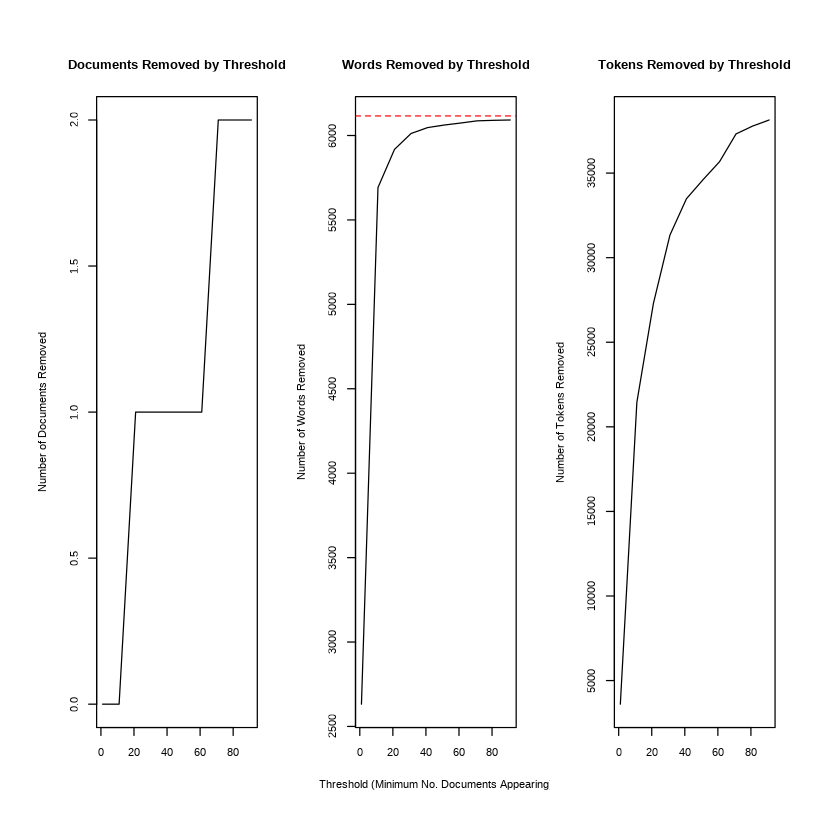

In [ ]:
plotRemoved(processed$documents,lower.thresh = seq(1, 100, by = 10))

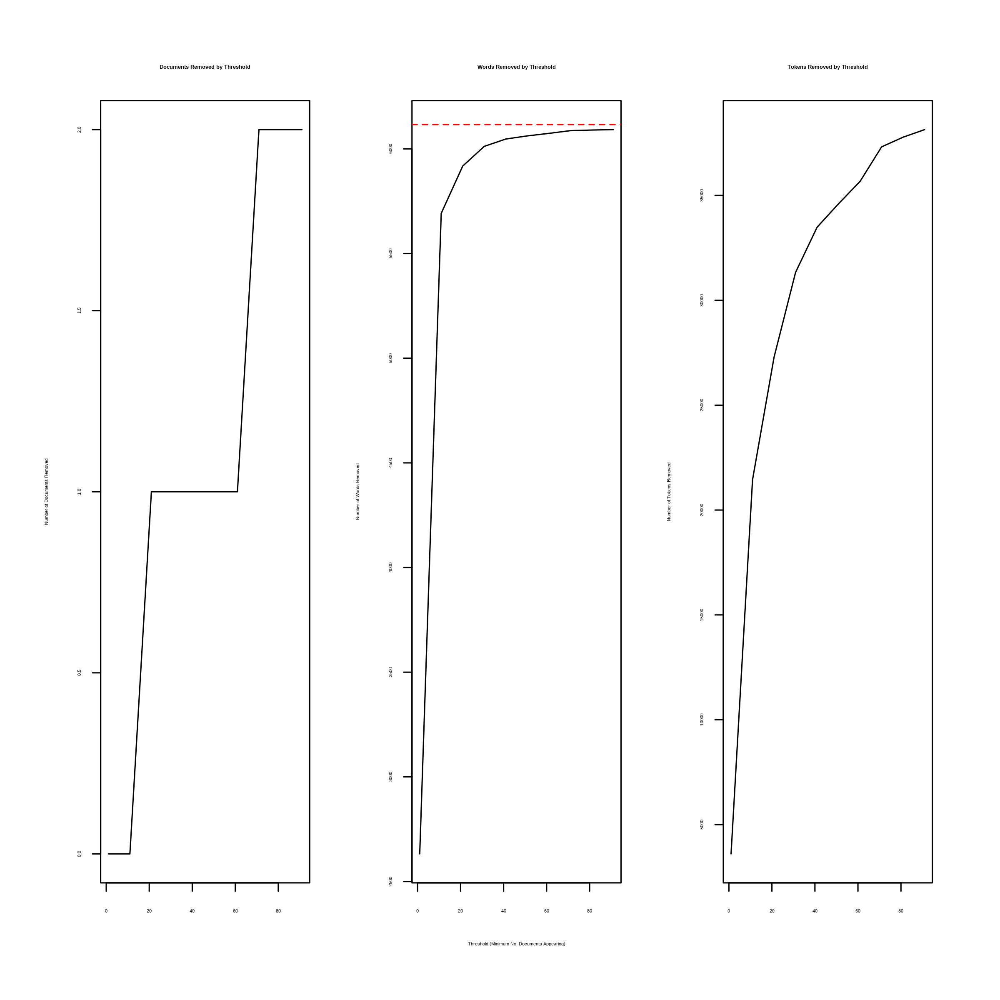

In [ ]:
options(repr.plot.width=8, repr.plot.height=8, repr.plot.res=300)
plotRemoved(processed$documents,lower.thresh = seq(1, 100, by = 10))

###Diagonos: SearchK



In [ ]:
storage <- searchK(out$documents, out$vocab, K =k, prevalence = ~singer+s(length), data = meta,gamma.prior='L1')
storage 

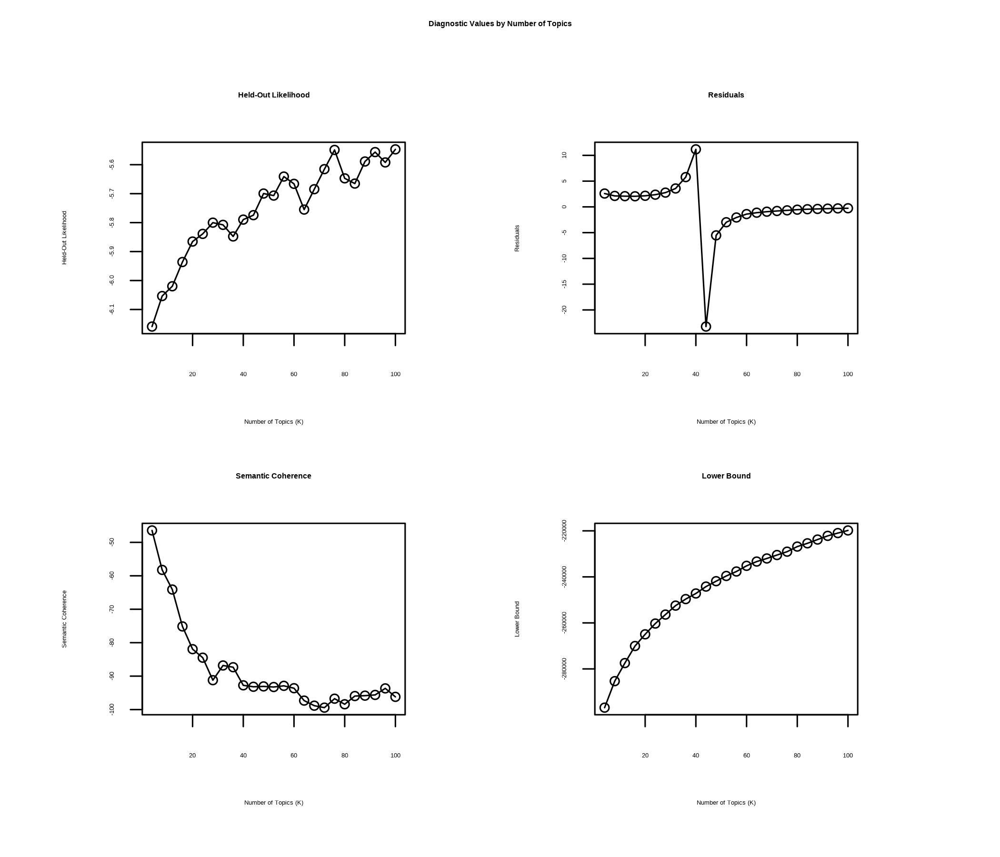

In [ ]:
plot(storage)



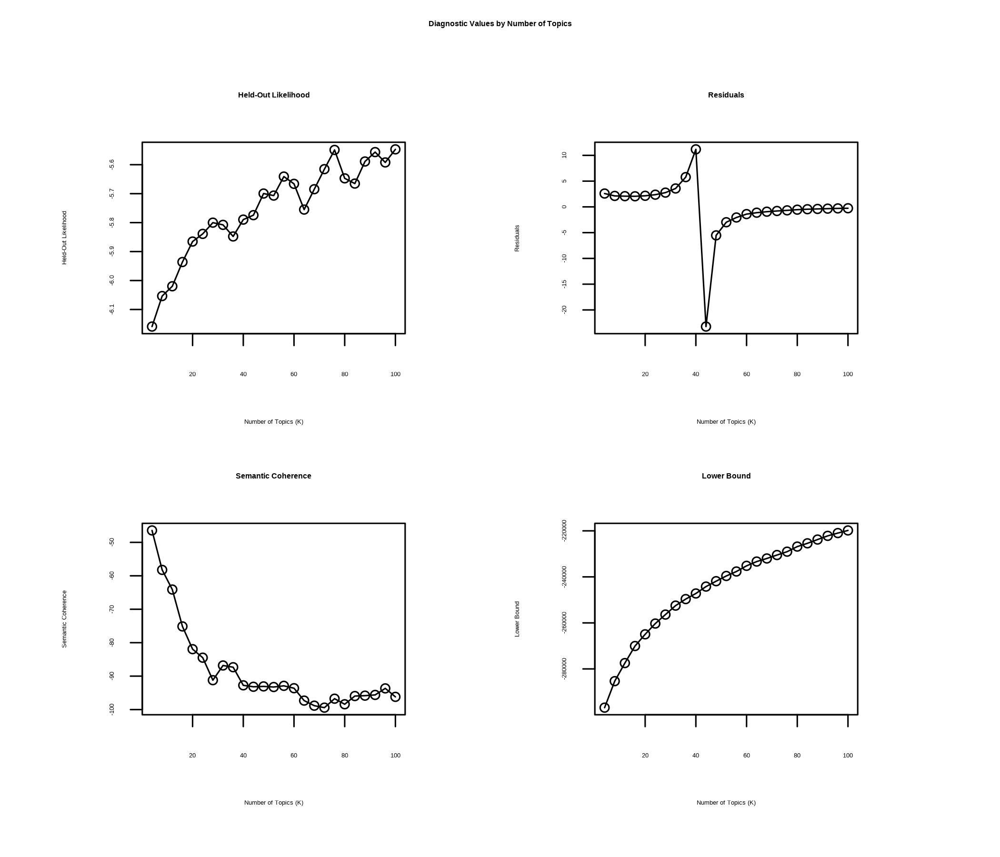

In [ ]:
options(repr.plot.width=7, repr.plot.height=6, repr.plot.res=300)
plot(storage) 

In [ ]:

model4<-stm(documents = out$documents, vocab = out$vocab, K = 4, prevalence = ~singer+s(length), max.em.its = 75, data = out$meta, init.type = "Spectral")

model8<-stm(documents = out$documents, vocab = out$vocab, K = 8, prevalence = ~singer+s(length), max.em.its = 75, data = out$meta, init.type = "Spectral")

model12<-stm(documents = out$documents, vocab = out$vocab, K = 12, prevalence = ~singer+s(length), max.em.its = 75, data = out$meta, init.type = "Spectral")

model16<-stm(documents = out$documents, vocab = out$vocab, K = 16, prevalence = ~singer+s(length), max.em.its = 75, data = out$meta, init.type = "Spectral")


Beginning Spectral Initialization 
	 Calculating the gram matrix...
	 Finding anchor words...
 	....
	 Recovering initialization...
 	..................................
Initialization complete.
...........................................................................................................
Completed E-Step (0 seconds). 
Completed M-Step. 
Completing Iteration 1 (approx. per word bound = -6.561) 
...........................................................................................................
Completed E-Step (0 seconds). 
Completed M-Step. 
Completing Iteration 2 (approx. per word bound = -6.522, relative change = 5.975e-03) 
...........................................................................................................
Completed E-Step (0 seconds). 
Completed M-Step. 
Completing Iteration 3 (approx. per word bound = -6.517, relative change = 7.936e-04) 
....................................................................................................

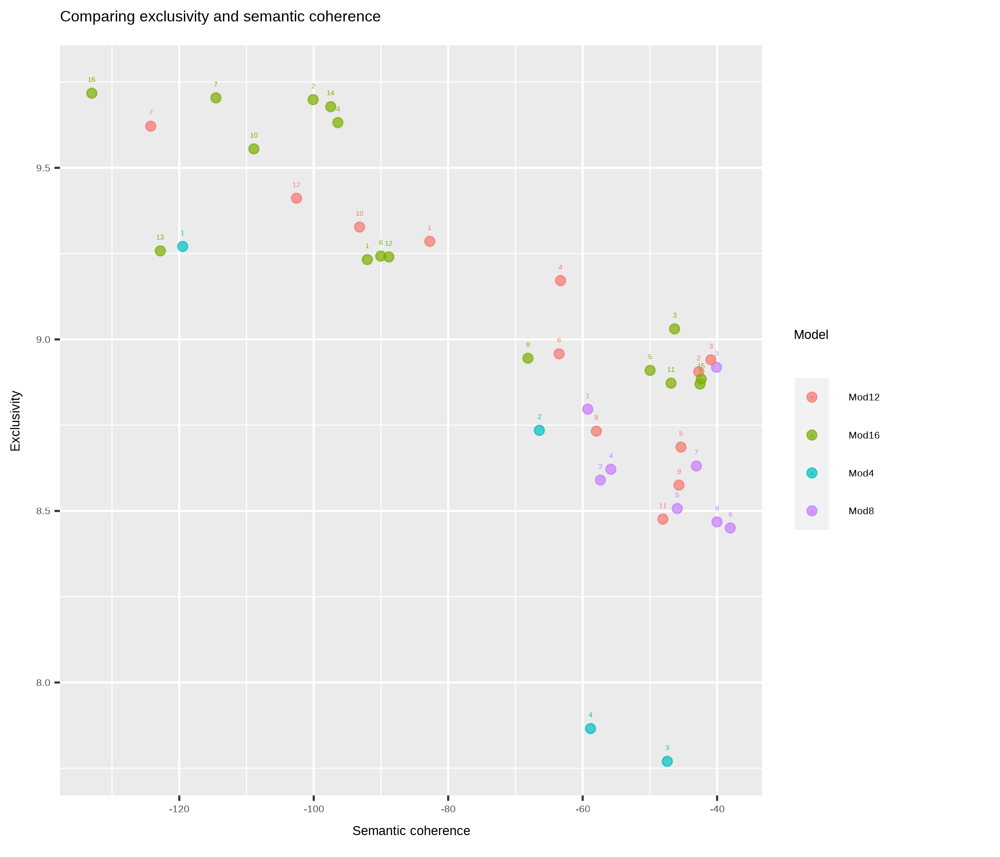

In [ ]:

suppressWarnings(library(ggplot2))
suppressWarnings(library(htmlwidgets))

M4ExSem<-as.data.frame(cbind(c(1:4),exclusivity(model4), semanticCoherence(model=model4, docs), "Mod4"))
M8ExSem<-as.data.frame(cbind(c(1:8),exclusivity(model8), semanticCoherence(model=model8, docs), "Mod8"))
M12ExSem<-as.data.frame(cbind(c(1:12),exclusivity(model12), semanticCoherence(model=model12, docs), "Mod12"))
M16ExSem<-as.data.frame(cbind(c(1:16),exclusivity(model16), semanticCoherence(model=model16, docs), "Mod16"))

ModsExSem<-rbind(M4ExSem, M8ExSem, M12ExSem,M16ExSem)
colnames(ModsExSem)<-c("K","Exclusivity", "SemanticCoherence", "Model")

ModsExSem$Exclusivity<-as.numeric(as.character(ModsExSem$Exclusivity))
ModsExSem$SemanticCoherence<-as.numeric(as.character(ModsExSem$SemanticCoherence))


options(repr.plot.width=7, repr.plot.height=6, repr.plot.res=300)

plotexcoer<-ggplot(ModsExSem, aes(SemanticCoherence, Exclusivity, color = Model))+geom_point(size = 2, alpha = 0.7) + 
geom_text(aes(label=K), nudge_y=.04)+
  labs(x = "Semantic coherence",
       y = "Exclusivity",
       title = "Comparing exclusivity and semantic coherence",cextex=3)
plotexcoer+theme(text = element_text(size = 20)) 





###TQ Model

#### Model Training
 

In [ ]:
poliblogSelect <- selectModel(documents = out$documents, vocab = out$vocab, K = 8, prevalence  = ~singer+s(length), max.em.its = 75, data = out$meta, runs = 20, seed = 8458159) 

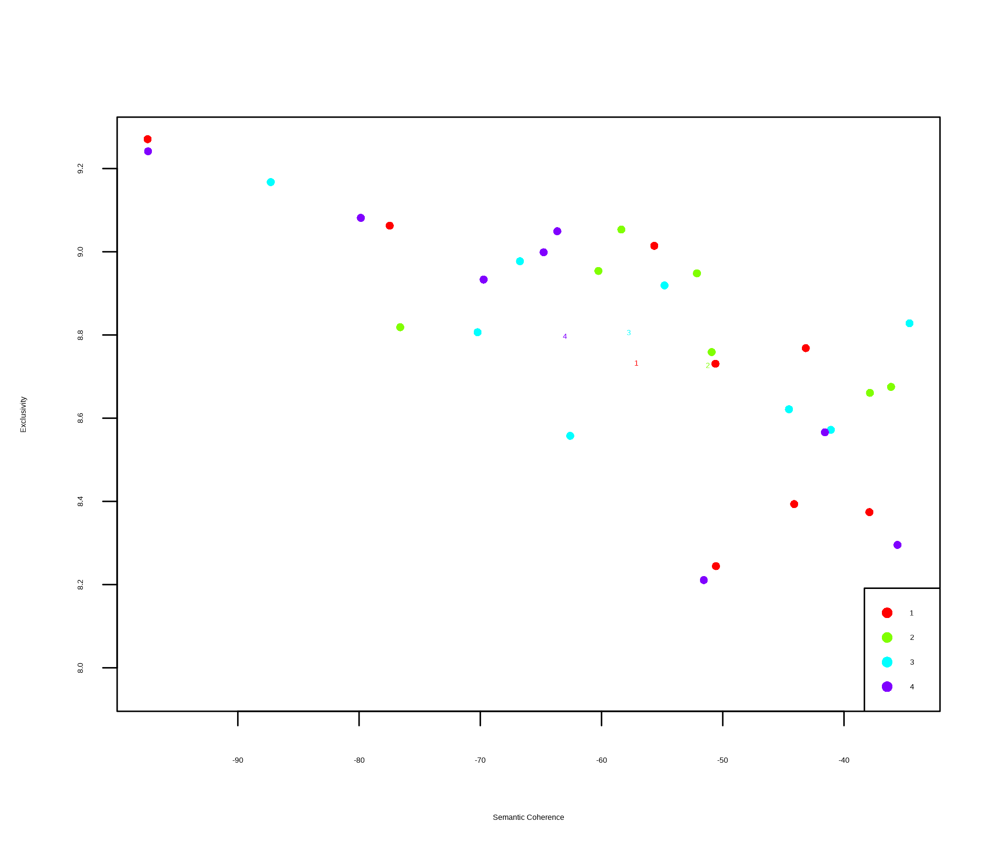

In [ ]:
options(repr.plot.width=7, repr.plot.height=6, repr.plot.res=300)
plotModels(poliblogSelect, legend.position = "bottomright")
plotexcoer+theme(text = element_text(size = 20))

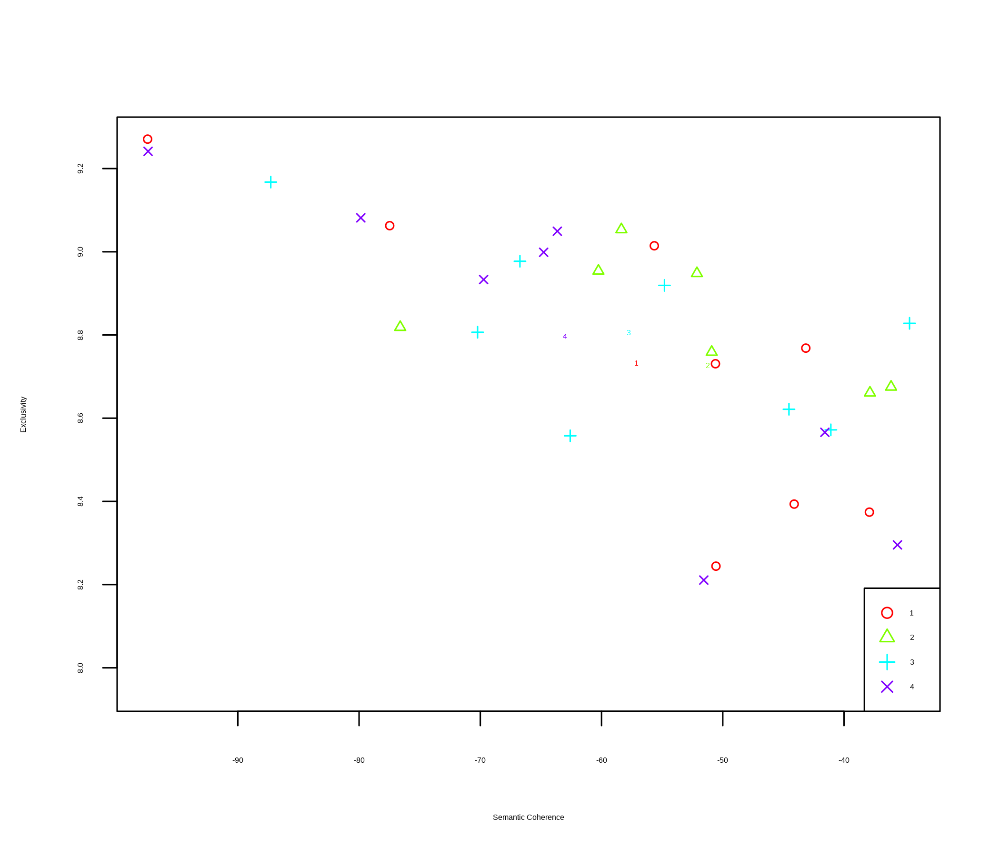

In [ ]:
options(repr.plot.width=7, repr.plot.height=6, repr.plot.res=300)
plotModels(poliblogSelect, pch = c(1, 2, 3, 4), legend.position = "bottomright")

In [ ]:
selectedmodel <- poliblogSelect$runout[[3]]

In [ ]:
selectedmodel

A topic model with 8 topics, 428 documents and a 3484 word dictionary.

[1] -59.24 -57.36 -40.10 -55.80 -45.93 -38.05 -43.08 -40.02
[1] 8.797 8.590 8.919 8.621 8.507 8.450 8.631 8.468


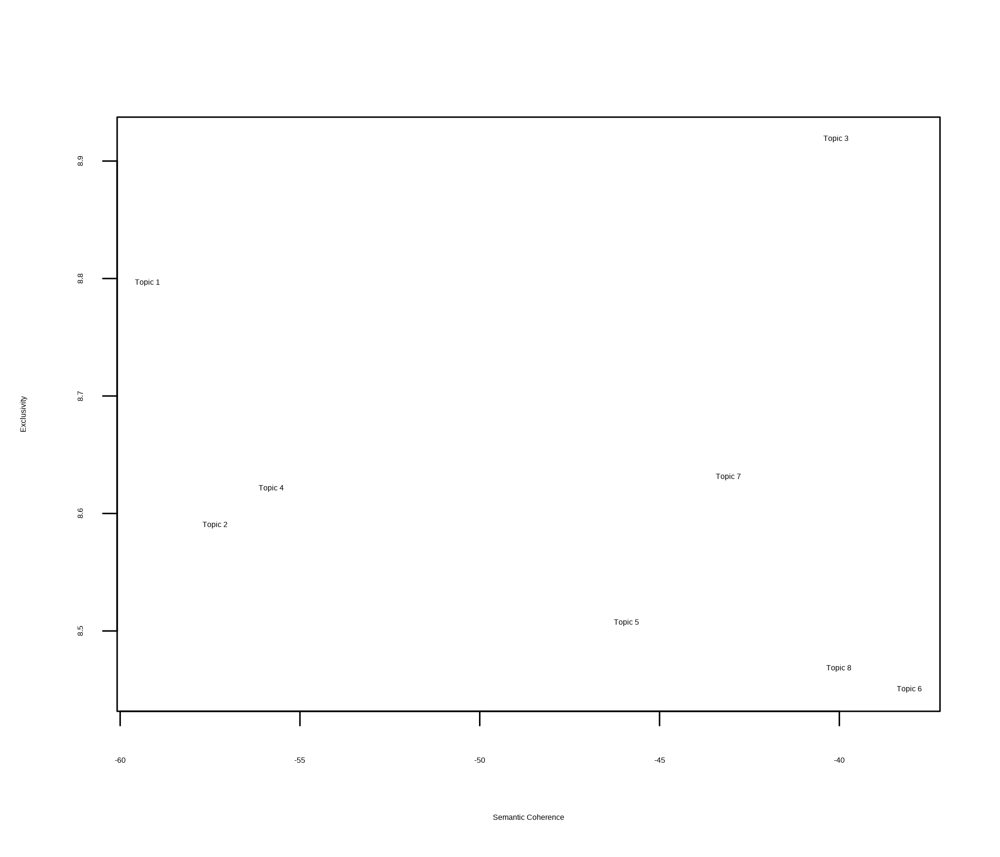

In [ ]:
options(repr.plot.width=7, repr.plot.height=6, repr.plot.res=300) 
topicQuality(model=poliblogPrevFit, documents=docs)

[1] -34.60 -54.81 -87.28 -70.22 -66.73 -62.58 -41.08 -44.54
[1] 8.828 8.919 9.167 8.807 8.977 8.558 8.572 8.621


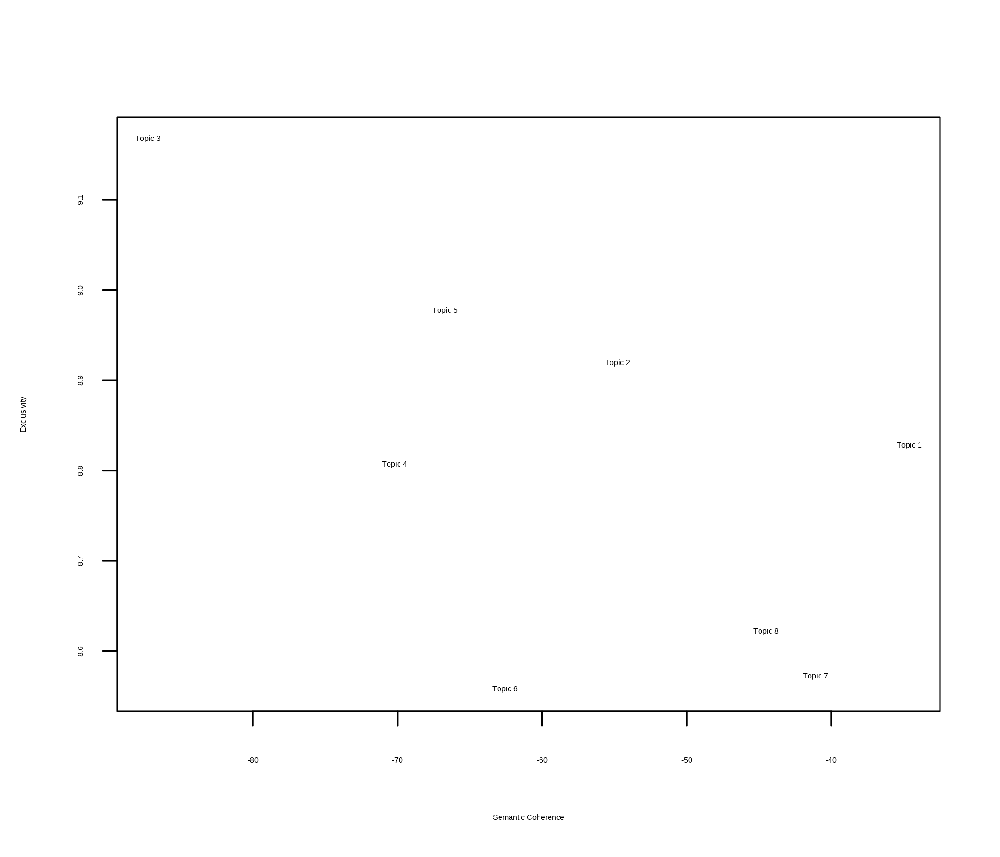

In [ ]:
options(repr.plot.width=7, repr.plot.height=6, repr.plot.res=300)
topicQuality(model=selectedmodel, documents=docs)

#### Topic visulization

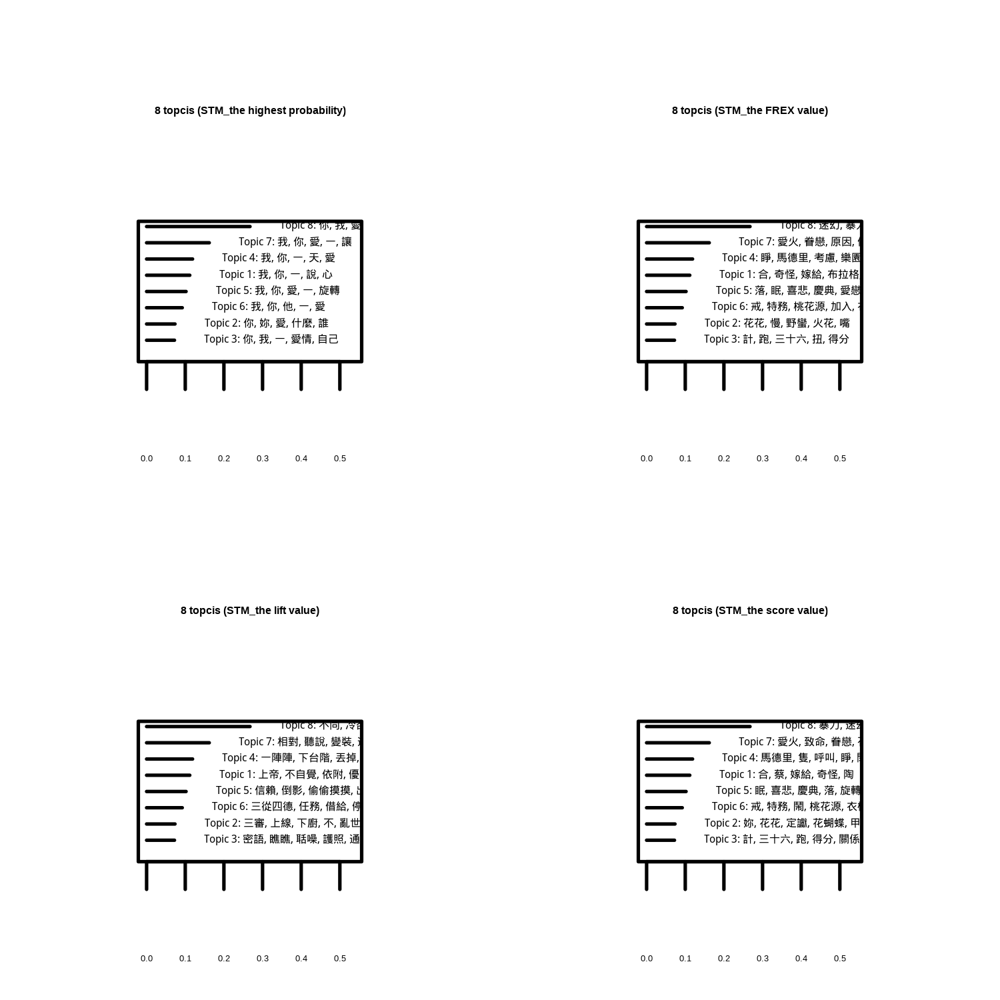

In [ ]:
options(repr.plot.width=3, repr.plot.height=3, repr.plot.res=500)
par(mfrow = c(2, 2), mar = c(2.5, 2.5, 4, 2.5))
library(showtext)
showtext_auto() #showchinese
plot(selectedmodel,n = 5, main= "8 topcis (STM_the highest probability)",text.cex = 1.2)

library(showtext)
showtext_auto() #showchinese
plot(selectedmodel,n = 5,,labeltype="frex", main= "8 topcis (STM_the FREX value)",text.cex = 1.2) #

library(showtext)
showtext_auto() #showchinese
plot(selectedmodel,n = 5,,labeltype="lift", main= "8 topcis (STM_the lift value)",text.cex = 1.2) #

library(showtext)
showtext_auto() #showchinese
plot(selectedmodel,n = 5,labeltype="score", main= "8 topcis (STM_the score value)",text.cex = 1.2) #


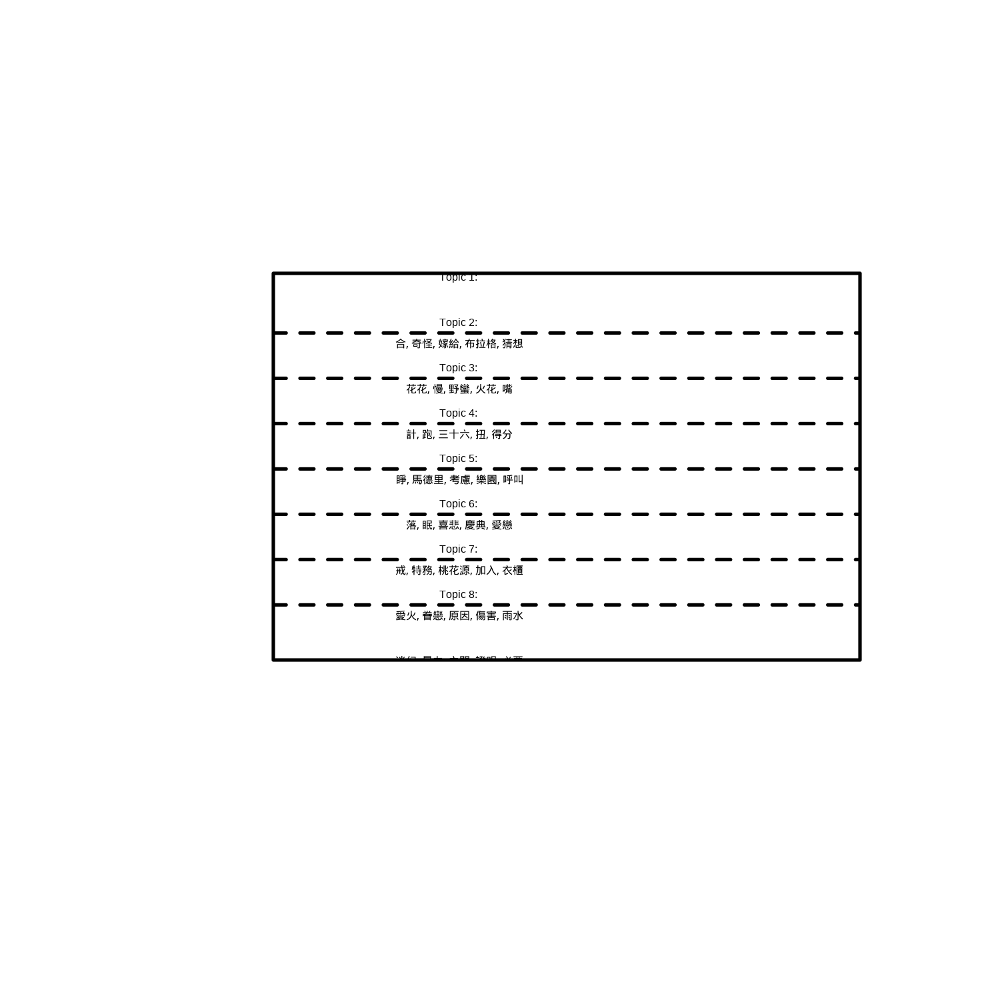

In [ ]:
library(showtext)
showtext_auto() #showchinese
plot(selectedmodel,type="labels", n = 5,labeltype="frex" )




#### Topic correlation

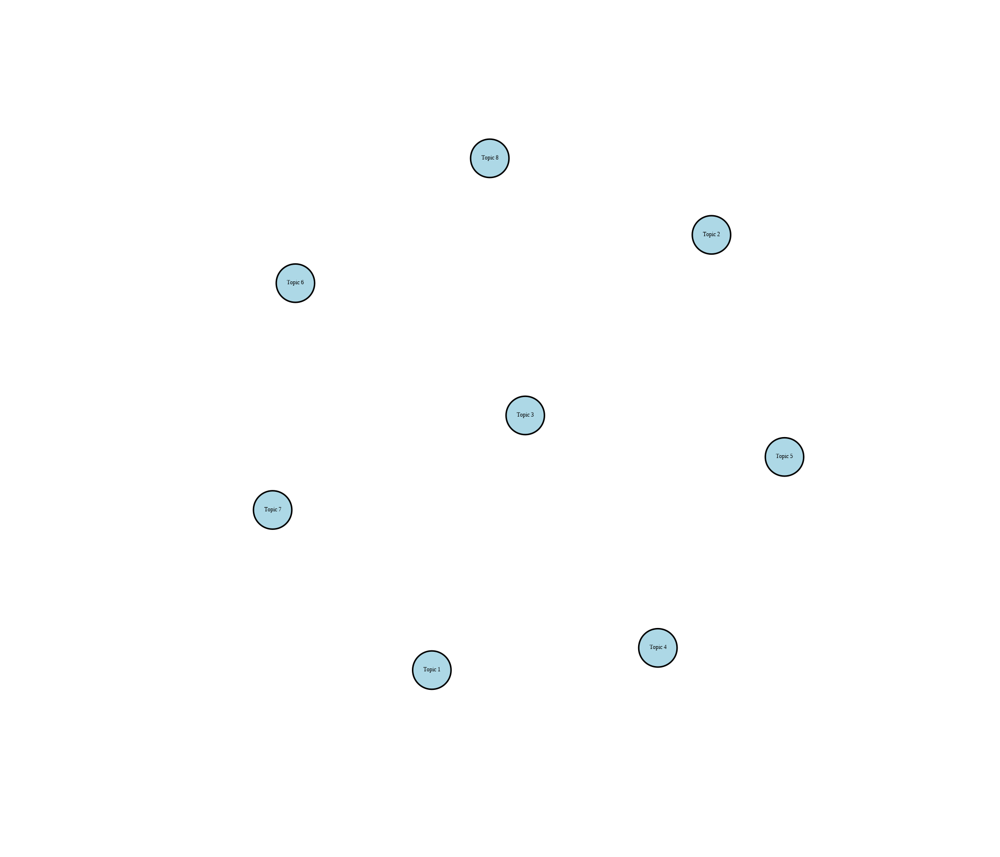

In [ ]:
options(repr.plot.width=7, repr.plot.height=6, repr.plot.res=300)
mod.out.corr <- topicCorr(selectedmodel)
plot(mod.out.corr,vertex.color = "lightblue")

#### Topical contrast

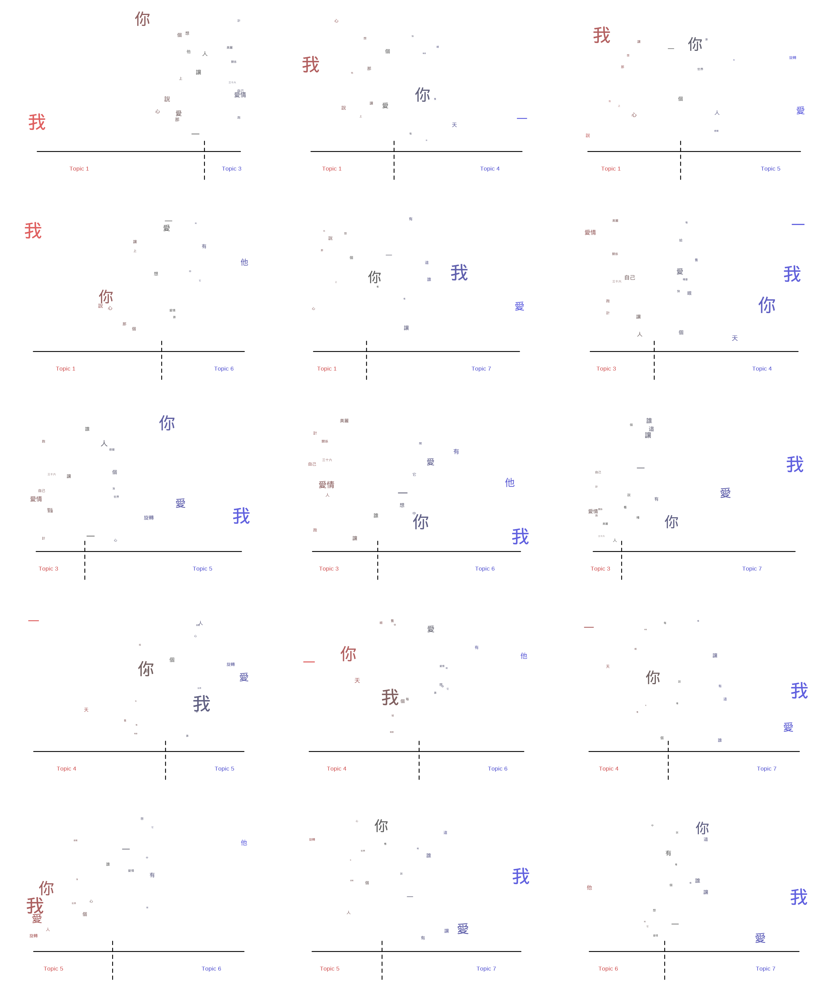

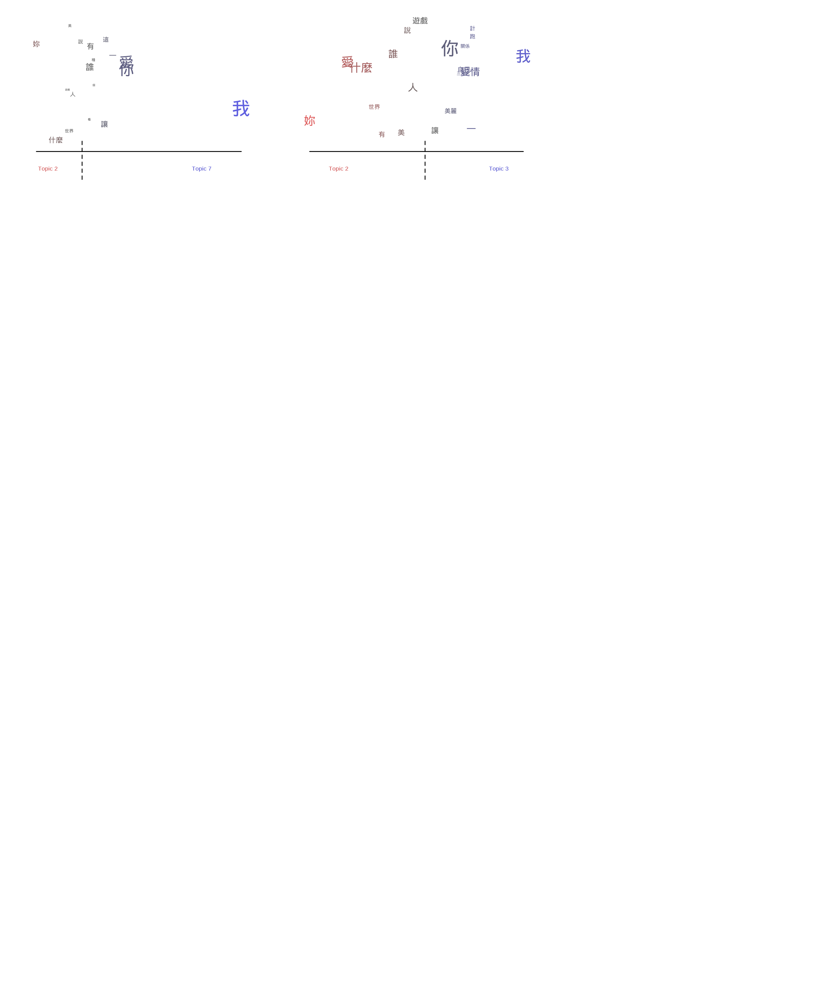

In [ ]:

par(mfrow=c(5,3), mar=c(1,1,1,1))

options(repr.plot.width=10, repr.plot.height=12, repr.plot.res=300)


library(showtext)
showtext_auto() #showchinese
plot.STM(selectedmodel, "perspectives", topics=c(1,3),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(1,4),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(1,5),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(1,6),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(1,7),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(3,4),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(3,5),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(3,6),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(3,7),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(4,5),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(4,6),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(4,7),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(5,6),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(5,7),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(6,7),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(2,7),width = 180,text.cex=3)
plot.STM(selectedmodel, "perspectives", topics=c(2,3),width = 180,text.cex=3)

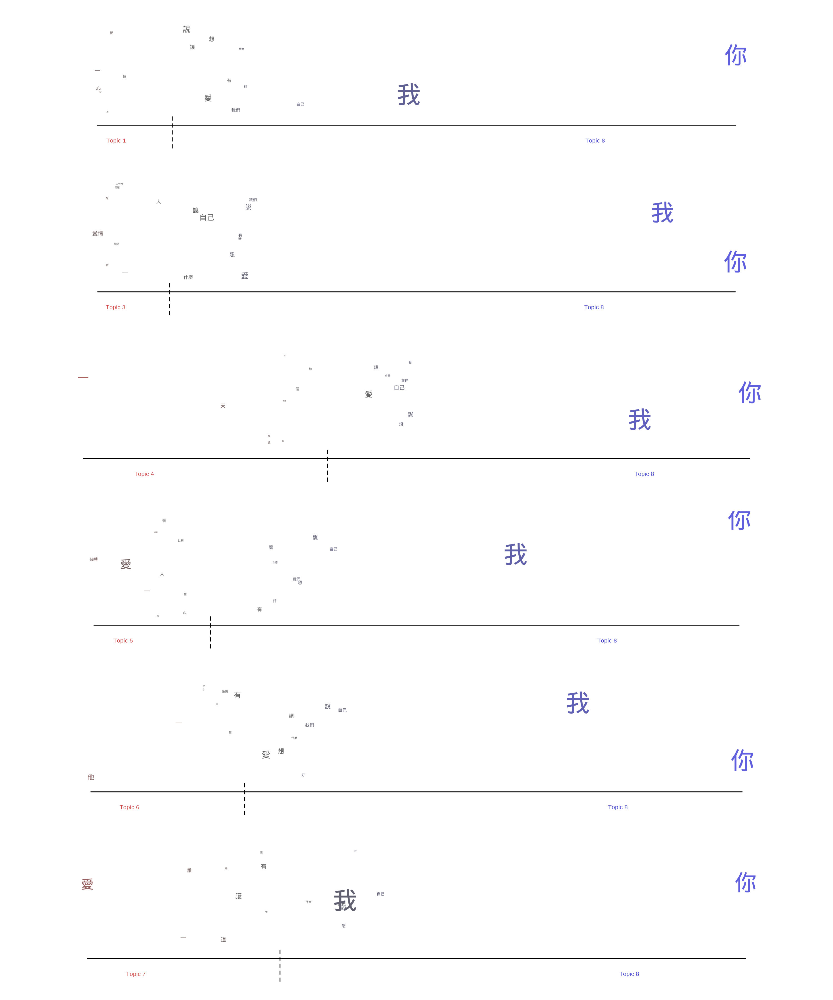

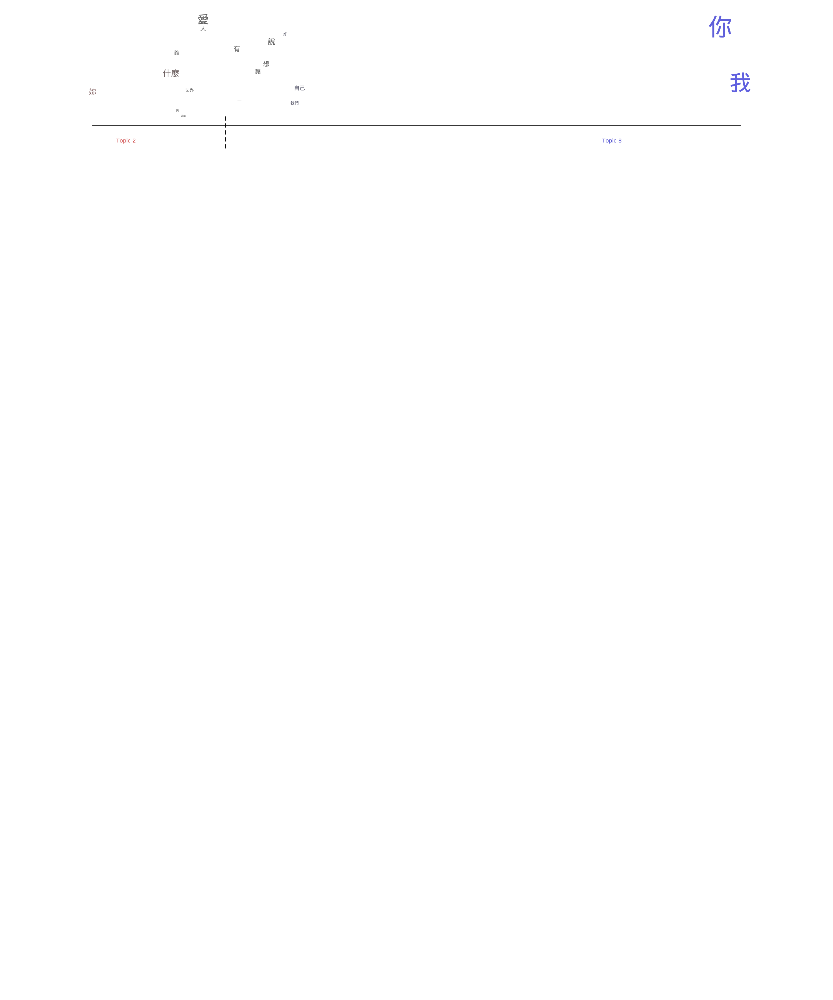

In [ ]:

par(mfrow=c(6,1), mar=c(1,1,1,1))

options(repr.plot.width=10, repr.plot.height=12, repr.plot.res=300)


library(showtext)
showtext_auto() #showchinese

plot.STM(selectedmodel, "perspectives", topics=c(1,8),width = 180,text.cex=4)#3
plot.STM(selectedmodel, "perspectives", topics=c(3,8),width = 180,text.cex=4)#3
plot.STM(selectedmodel, "perspectives", topics=c(4,8),width = 180,text.cex=4)#3
plot.STM(selectedmodel, "perspectives", topics=c(5,8),width = 180,text.cex=4)#3
plot.STM(selectedmodel, "perspectives", topics=c(6,8),width = 180,text.cex=4)#3
plot.STM(selectedmodel, "perspectives", topics=c(7,8),width = 180,text.cex=4)#3
plot.STM(selectedmodel, "perspectives", topics=c(2,8),width = 180,text.cex=4)#3

####Estimate effect

In [ ]:
out$meta$singer<-as.factor(out$meta$singer)
prep<-estimateEffect(1:8 ~singer+s(length), selectedmodel, metadata=out$meta, uncertainty="Global")

summary(prep, nsim=1000)


Call:
estimateEffect(formula = 1:8 ~ singer + s(length), stmobj = selectedmodel, 
    metadata = out$meta, uncertainty = "Global")


Topic 1:

Coefficients:
            Estimate Std. Error t value Pr(>|t|)
(Intercept)  0.00443    0.15365    0.03     0.98
singertsai   0.02259    0.03100    0.73     0.47
s(length)1   0.21130    0.34105    0.62     0.54
s(length)2   0.11916    0.19412    0.61     0.54
s(length)3   0.06502    0.17651    0.37     0.71
s(length)4   0.06177    0.16525    0.37     0.71
s(length)5   0.07074    0.16735    0.42     0.67
s(length)6   0.08977    0.16447    0.55     0.59
s(length)7   0.10370    0.16410    0.63     0.53
s(length)8   0.31540    0.24102    1.31     0.19
s(length)9  -0.31100    0.39324   -0.79     0.43
s(length)10  0.01699    0.27822    0.06     0.95


Topic 2:

Coefficients:
            Estimate Std. Error t value Pr(>|t|)   
(Intercept)   0.0922     0.1544    0.60   0.5506   
singertsai    0.0722     0.0258    2.80   0.0054 **
s(length)1   -0.0702   

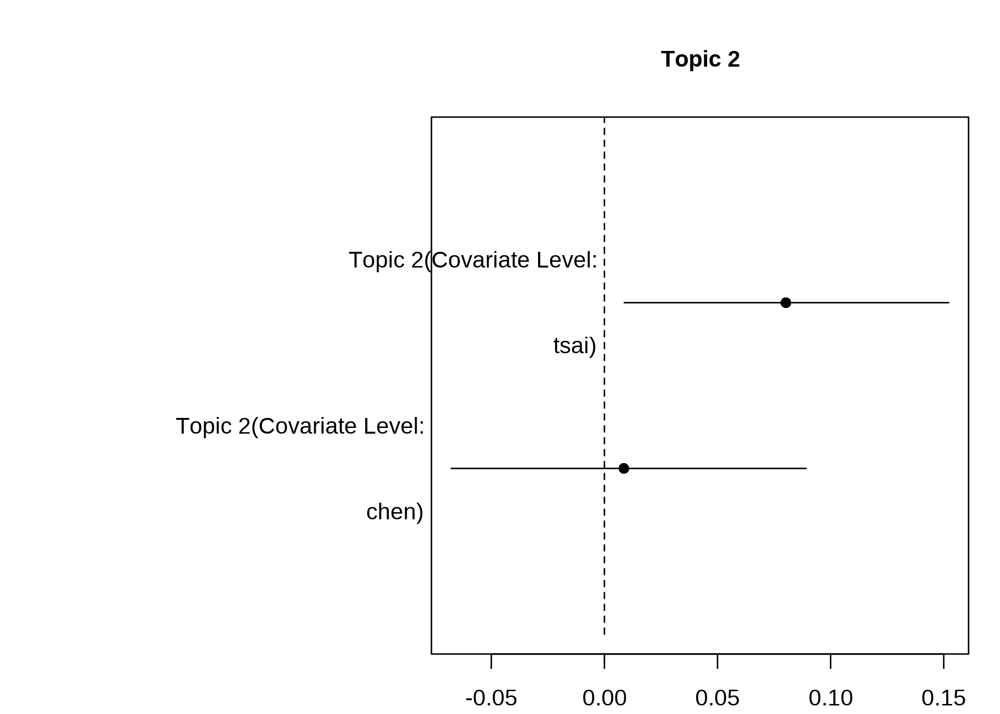

In [ ]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res=300)
par(mar=c(2,15,4,1)+.1,cex.lab=3, cex.axis=3, cex.main=3)
#The 'mar' argument of 'par' 
#sets the width of the margins in the order: 'bottom', 'left', 'top', 'right'. The default is to set 'left' to 4, here I have changed it to 6.
#https://stackoverflow.com/questions/2807060/r-is-plotting-labels-off-the-page
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 2, main = "Topic 2")

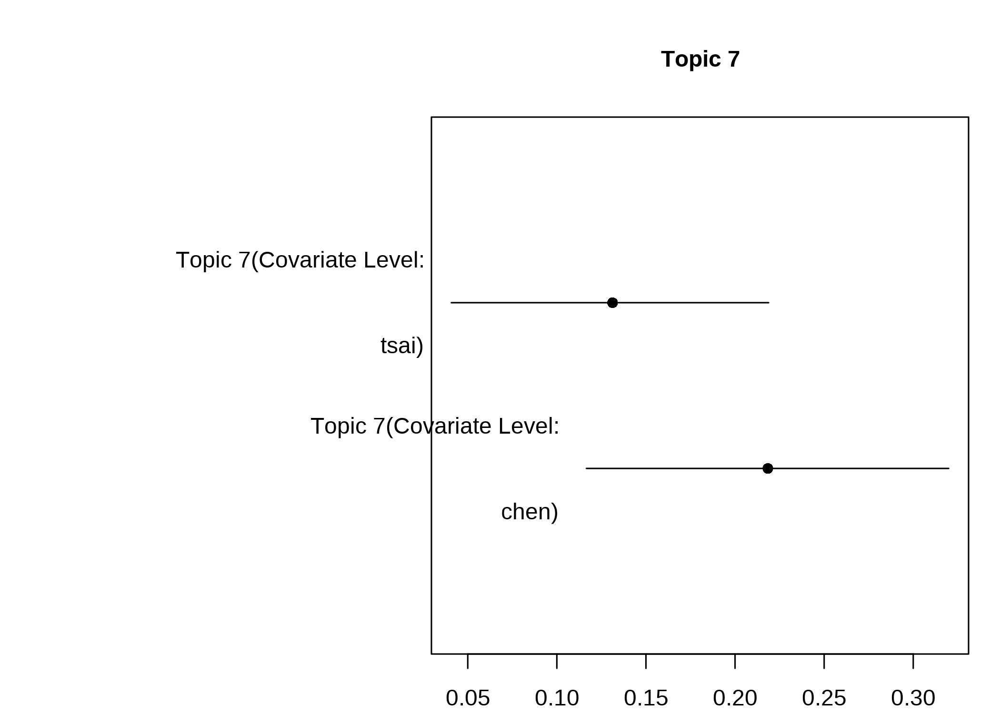

In [ ]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res=300)
par(mar=c(2,15,4,1)+.1,cex.lab=3, cex.axis=3, cex.main=3)
#The 'mar' argument of 'par' 
#sets the width of the margins in the order: 'bottom', 'left', 'top', 'right'. The default is to set 'left' to 4, here I have changed it to 6.
#https://stackoverflow.com/questions/2807060/r-is-plotting-labels-off-the-page
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 7, main = "Topic 7")

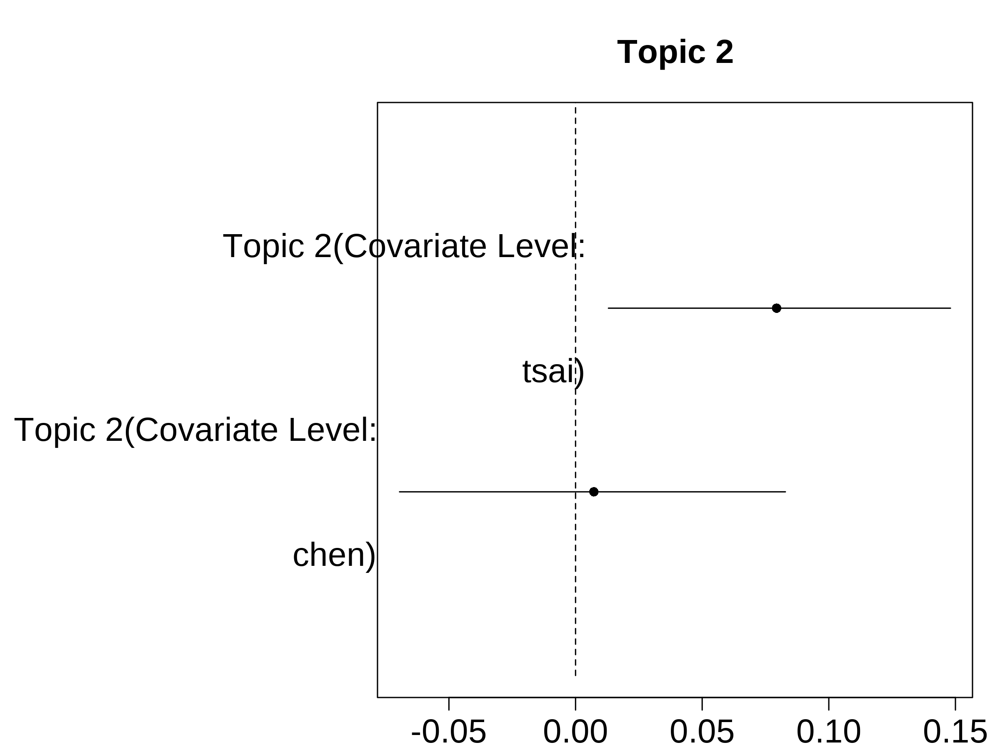

In [ ]:
options(repr.plot.width=8, repr.plot.height=6, repr.plot.res=300)
par(mar=c(2,15,4,1)+.1,cex.lab=5, cex.axis=5, cex.main=5)
#The 'mar' argument of 'par' 
#sets the width of the margins in the order: 'bottom', 'left', 'top', 'right'. The default is to set 'left' to 4, here I have changed it to 6.
#https://stackoverflow.com/questions/2807060/r-is-plotting-labels-off-the-page
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 2, main = "Topic 2")


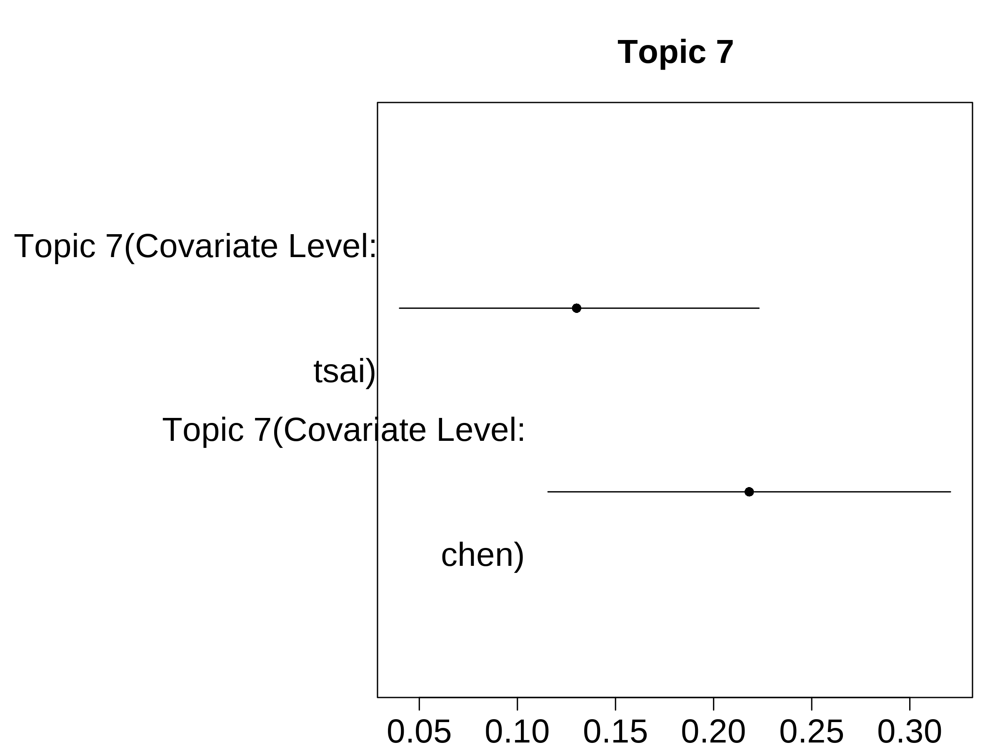

In [ ]:
options(repr.plot.width=8, repr.plot.height=6, repr.plot.res=300)
par(mar=c(2,15,4,1)+.1,cex.lab=5, cex.axis=5, cex.main=5)
#The 'mar' argument of 'par' 
#sets the width of the margins in the order: 'bottom', 'left', 'top', 'right'. The default is to set 'left' to 4, here I have changed it to 6.
#https://stackoverflow.com/questions/2807060/r-is-plotting-labels-off-the-page
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 7, main = "Topic 7")

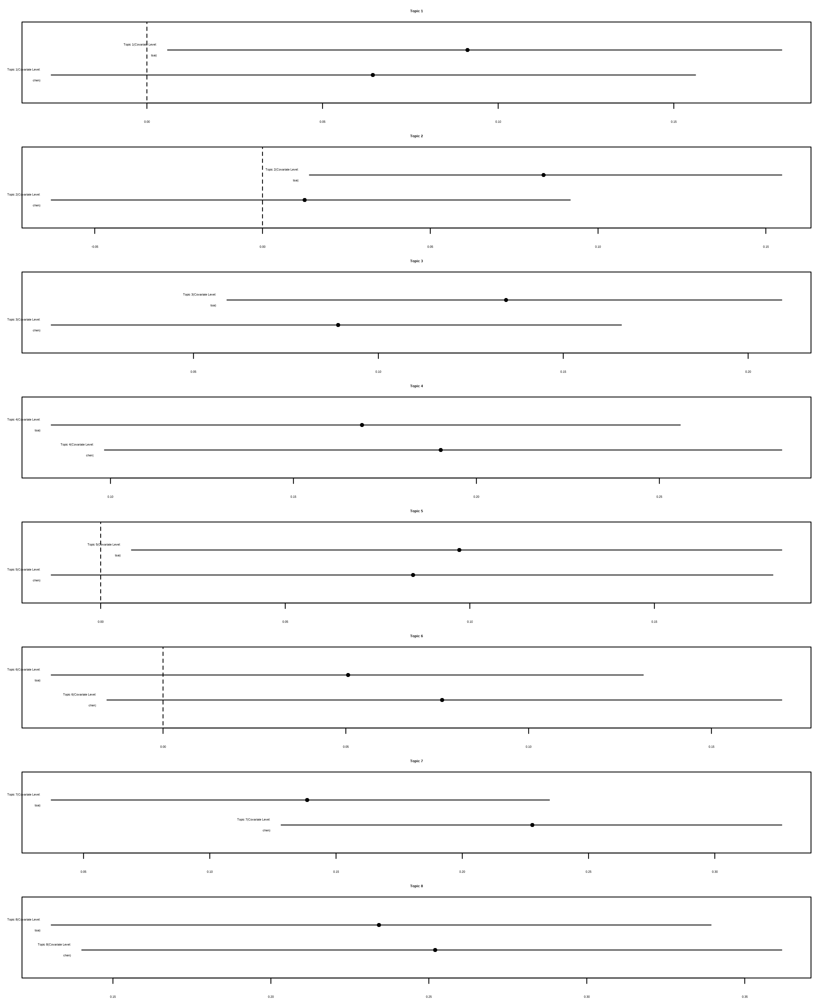

In [ ]:

options(repr.plot.width=10, repr.plot.height=12, repr.plot.res=300)

par(mfrow=c(8,1), mar=c(2,2,2,2))
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 1, main = "Topic 1")
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 2, main = "Topic 2")
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 3, main = "Topic 3")
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 4, main = "Topic 4")
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 5, main = "Topic 5")
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 6, main = "Topic 6")
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 7, main = "Topic 7")
plot(prep, "singer", model=selectedmodel,
method="pointestimate", topics = 8, main = "Topic 8")

## IA Model

### Model training 

In [ ]:
contentSelect <- selectModel(documents = out$documents, vocab = out$vocab, K = 8, prevalence  = ~singer+s(length), content =~singer, max.em.its = 75, data = out$meta, runs = 20, seed = 8458159)


Casting net 
1 models in net 
2 models in net 
3 models in net 
4 models in net 
5 models in net 
6 models in net 
7 models in net 
8 models in net 
9 models in net 
10 models in net 
11 models in net 
12 models in net 
13 models in net 
14 models in net 
15 models in net 
16 models in net 
17 models in net 
18 models in net 
19 models in net 
20 models in net 
Running select models 
1 select model run 
Beginning LDA Initialization 
...........................................................................................................
Completed E-Step (0 seconds). 
......................................................................................................
Completed M-Step (10 seconds). 
Completing Iteration 1 (approx. per word bound = -6.364) 
...........................................................................................................
Completed E-Step (0 seconds). 
............................................................................................

In [ ]:
contentSelect$runout

[[1]]
A topic model with 8 topics, 428 documents and a 3484 word dictionary.

[[2]]
A topic model with 8 topics, 428 documents and a 3484 word dictionary.

[[3]]
A topic model with 8 topics, 428 documents and a 3484 word dictionary.

[[4]]
A topic model with 8 topics, 428 documents and a 3484 word dictionary.


In [ ]:
plotModels(contentSelect, pch = c(1, 2, 3, 4), legend.position = "bottomright")


[1] "Model 1 has on average -72.6553878980206 semantic coherence and 0.926808266360505 sparsity"
[1] "Model 2 has on average -71.5237151082896 semantic coherence and 0.927780966960071 sparsity"
[1] "Model 3 has on average -70.406812862862 semantic coherence and 0.924942594718714 sparsity"
[1] "Model 4 has on average -70.809340476223 semantic coherence and 0.927956371986223 sparsity"


In [ ]:
selectedcontentmodel <- contentSelect$runout[[2]]

### Topic Correlation

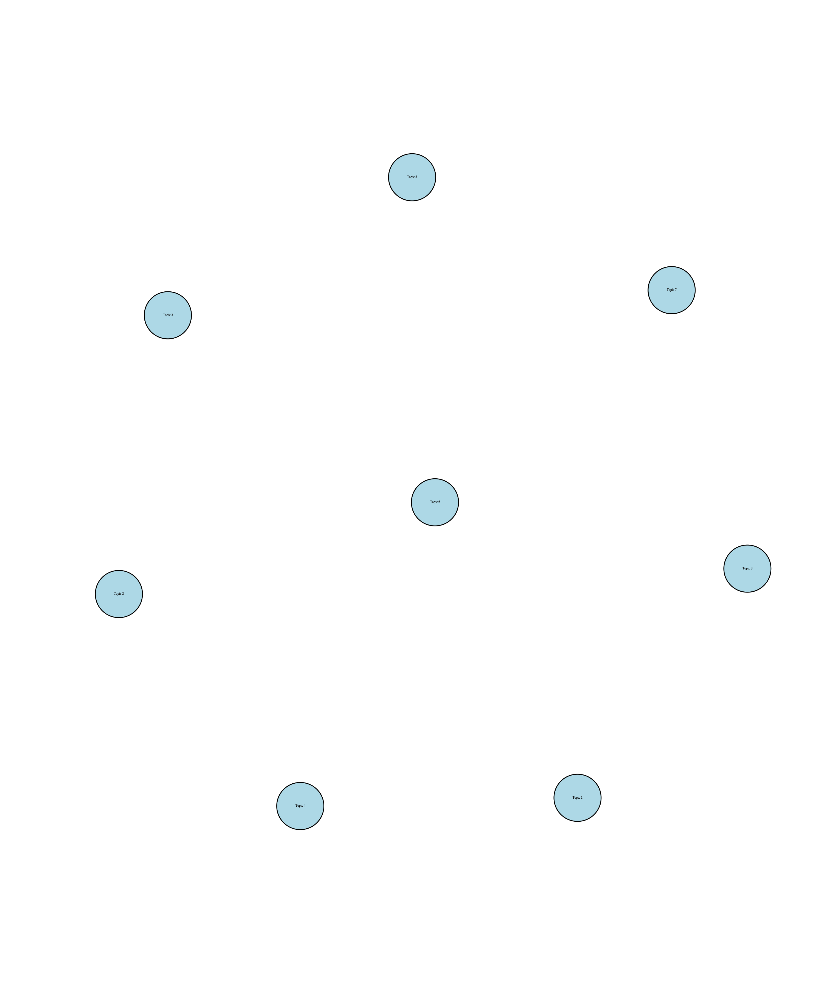

In [ ]:
mod.out.corr <- topicCorr(selectedcontentmodel)
plot(mod.out.corr,vertex.color = "lightblue")

### Topic visualization

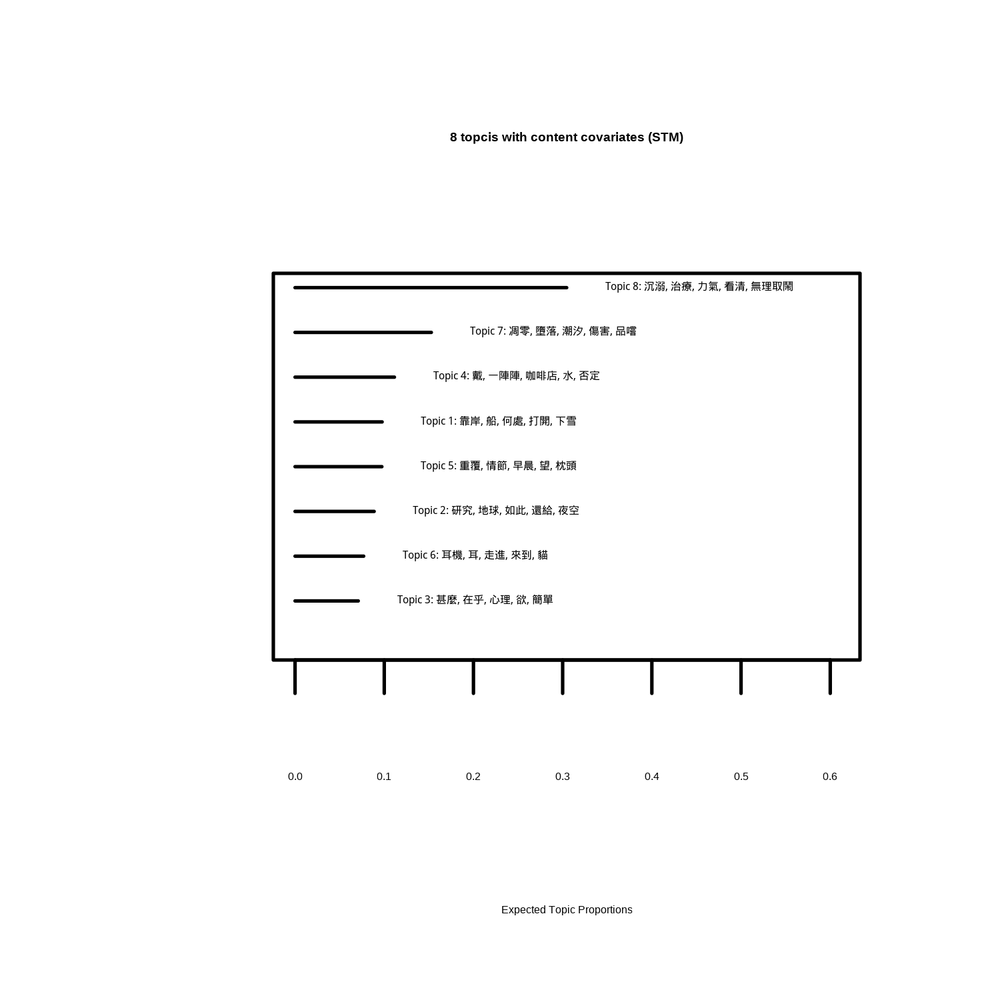

In [ ]:
options(repr.plot.width=3, repr.plot.height=3, repr.plot.res=500)

plot(selectedcontentmodel,n = 5, main= "8 topcis with content covariates (STM)",text.cex = 1) #,labeltype="frex"


### Topical contrast

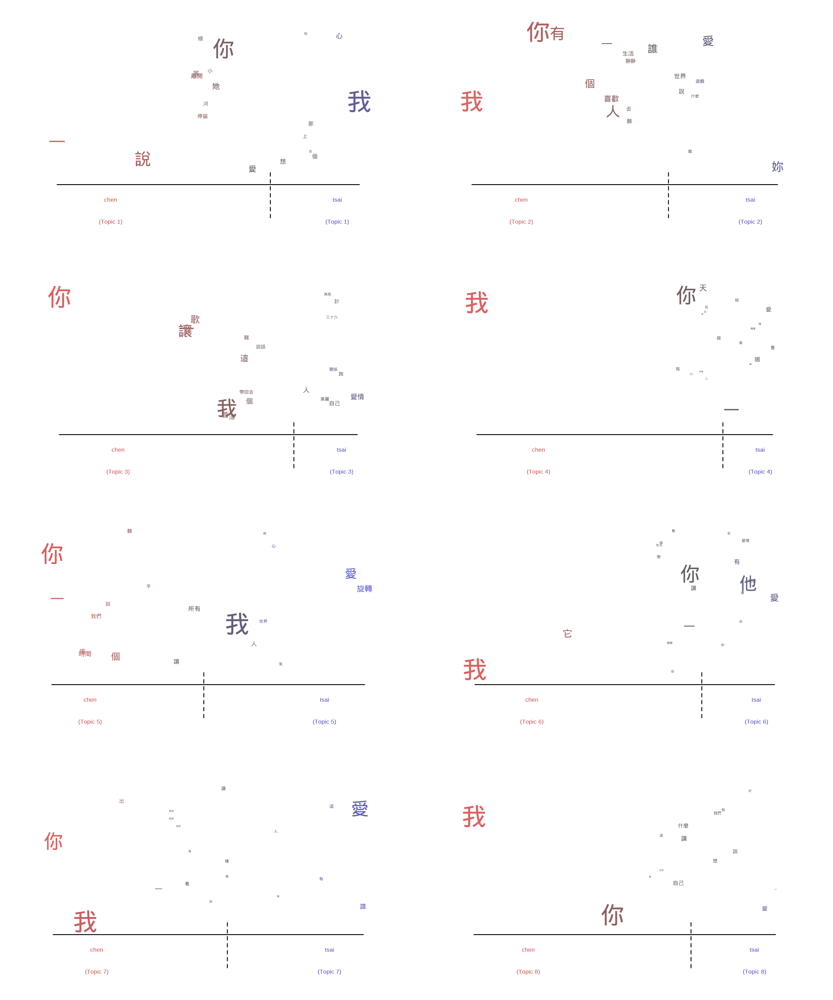

In [ ]:

options(repr.plot.width=10, repr.plot.height=12, repr.plot.res=300)

par(mfrow=c(4,2), mar=c(2,2,2,2))
plot(selectedcontentmodel, type = "perspectives", topics = 1,width = 180,text.cex=4)
plot(selectedcontentmodel, type = "perspectives", topics = 2,width = 180,text.cex=4)
plot(selectedcontentmodel, type = "perspectives", topics = 3,width = 180,text.cex=4)
plot(selectedcontentmodel, type = "perspectives", topics = 4,width = 180,text.cex=4)
plot(selectedcontentmodel, type = "perspectives", topics = 5,width = 180,text.cex=4)
plot(selectedcontentmodel, type = "perspectives", topics = 6,width = 180,text.cex=4)
plot(selectedcontentmodel, type = "perspectives", topics = 7,width = 180,text.cex=4)
plot(selectedcontentmodel, type = "perspectives", topics = 8,width = 180,text.cex=4)

### Estimate effect

In [ ]:
#without +s(length)
out$meta$singer<-as.factor(out$meta$singer)
prep<-estimateEffect(1:8 ~singer, selectedcontentmodel, metadata=out$meta, uncertainty="Global")

summary(prep, nsim=1000)



Call:
estimateEffect(formula = 1:8 ~ singer, stmobj = selectedcontentmodel, 
    metadata = out$meta, uncertainty = "Global")


Topic 1:

Coefficients:
            Estimate Std. Error t value Pr(>|t|)   
(Intercept)   0.0695     0.0222    3.13   0.0019 **
singertsai    0.0500     0.0276    1.81   0.0705 . 
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1


Topic 2:

Coefficients:
            Estimate Std. Error t value   Pr(>|t|)    
(Intercept)   0.1189     0.0238    5.00 0.00000082 ***
singertsai   -0.0389     0.0283   -1.38       0.17    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1


Topic 3:

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.07675    0.02190    3.50  0.00051 ***
singertsai   0.00844    0.02584    0.33  0.74428    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1


Topic 4:

Coefficients:
            Estimate Std. Error t value       Pr(>|t|)    
(Intercept)   0.1686     0.02

In [ ]:
#with +s(length)
out$meta$singer<-as.factor(out$meta$singer)
prep<-estimateEffect(1:8 ~singer+s(length), selectedcontentmodel, metadata=out$meta, uncertainty="Global")

summary(prep, nsim=1000)


Call:
estimateEffect(formula = 1:8 ~ singer + s(length), stmobj = selectedcontentmodel, 
    metadata = out$meta, uncertainty = "Global")


Topic 1:

Coefficients:
            Estimate Std. Error t value Pr(>|t|)
(Intercept)  0.05426    0.15958    0.34     0.73
singertsai   0.03444    0.02995    1.15     0.25
s(length)1   0.25414    0.36453    0.70     0.49
s(length)2  -0.08198    0.18357   -0.45     0.66
s(length)3   0.03098    0.18565    0.17     0.87
s(length)4  -0.00640    0.17313   -0.04     0.97
s(length)5  -0.00747    0.17400   -0.04     0.97
s(length)6   0.01893    0.17027    0.11     0.91
s(length)7  -0.00301    0.17312   -0.02     0.99
s(length)8   0.35997    0.23377    1.54     0.12
s(length)9  -0.47856    0.39170   -1.22     0.22
s(length)10 -0.02782    0.27218   -0.10     0.92


Topic 2:

Coefficients:
            Estimate Std. Error t value Pr(>|t|)
(Intercept)  0.10503    0.14633    0.72     0.47
singertsai  -0.04249    0.02796   -1.52     0.13
s(length)1  -0.04682    0

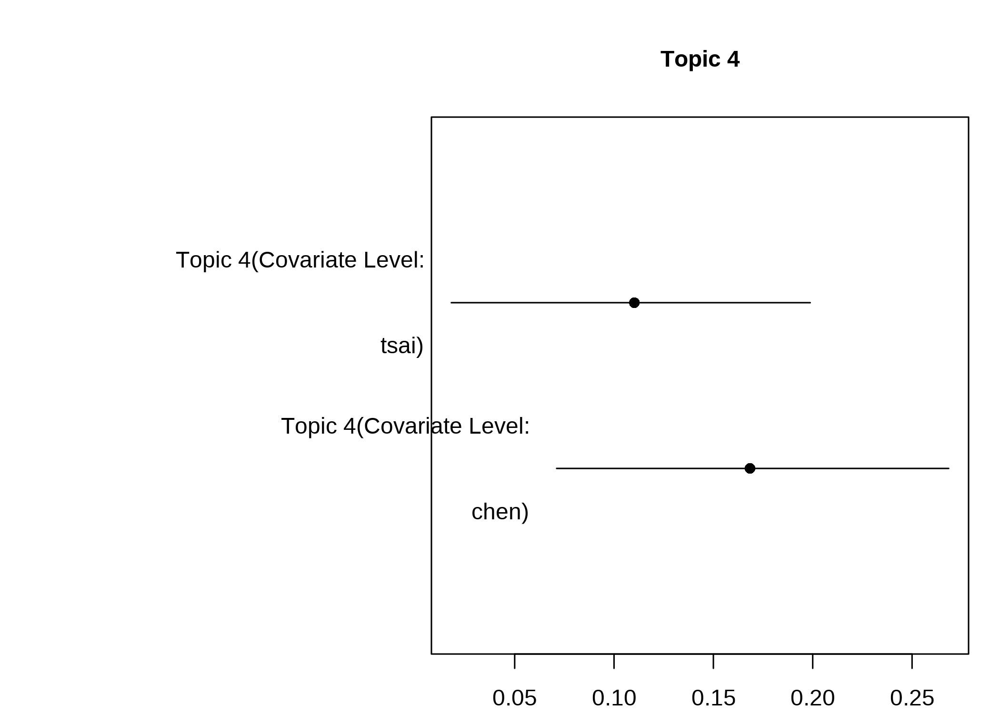

In [ ]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res=300)
par(mar=c(2,15,4,1)+.1,cex.lab=3, cex.axis=3, cex.main=3)
#The 'mar' argument of 'par' 
#sets the width of the margins in the order: 'bottom', 'left', 'top', 'right'. The default is to set 'left' to 4, here I have changed it to 6.
#https://stackoverflow.com/questions/2807060/r-is-plotting-labels-off-the-page
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 4, main = "Topic 4")

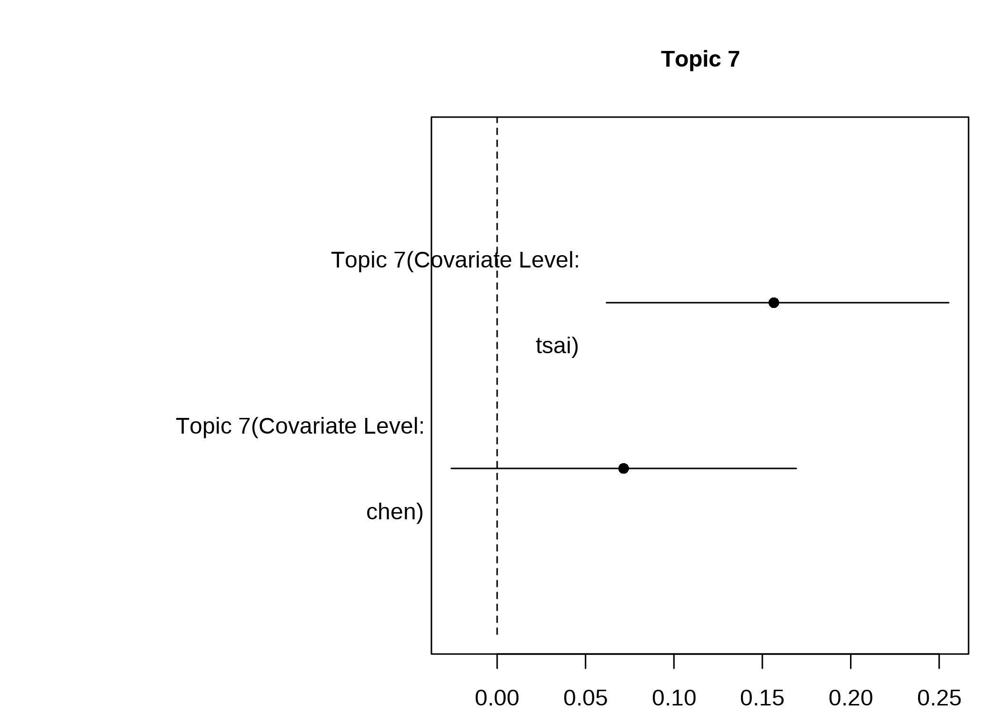

In [ ]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res=300)
par(mar=c(2,15,4,1)+.1,cex.lab=3, cex.axis=3, cex.main=3)
#The 'mar' argument of 'par' 
#sets the width of the margins in the order: 'bottom', 'left', 'top', 'right'. The default is to set 'left' to 4, here I have changed it to 6.
#https://stackoverflow.com/questions/2807060/r-is-plotting-labels-off-the-page
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 7, main = "Topic 7")

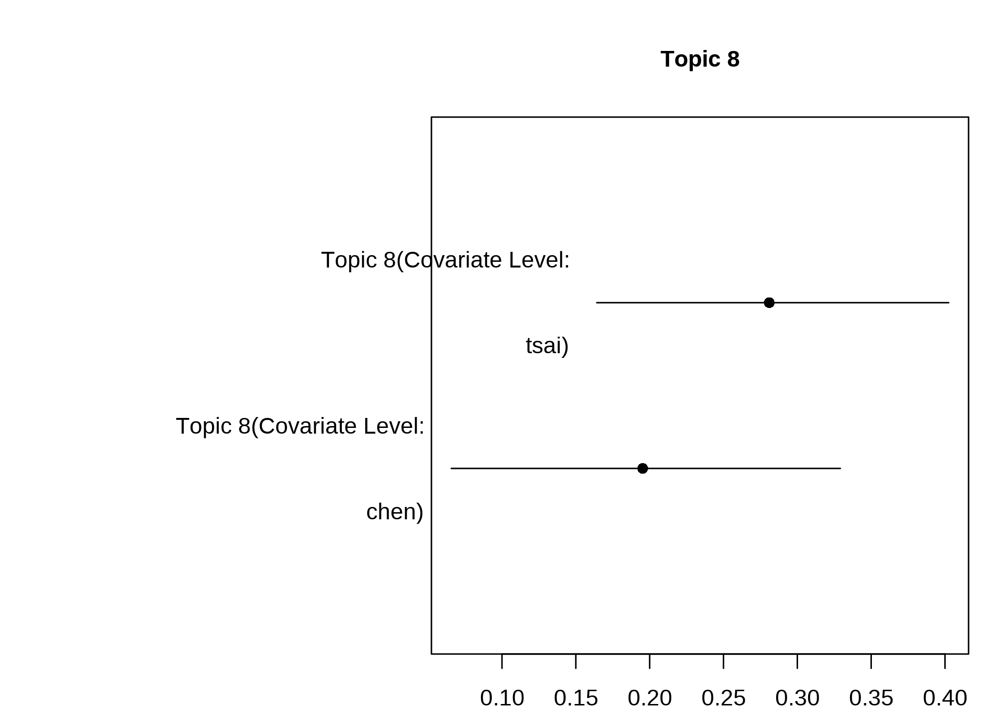

In [ ]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res=300)
par(mar=c(2,15,4,1)+.1,cex.lab=3, cex.axis=3, cex.main=3)
#The 'mar' argument of 'par' 
#sets the width of the margins in the order: 'bottom', 'left', 'top', 'right'. The default is to set 'left' to 4, here I have changed it to 6.
#https://stackoverflow.com/questions/2807060/r-is-plotting-labels-off-the-page
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 8, main = "Topic 8")

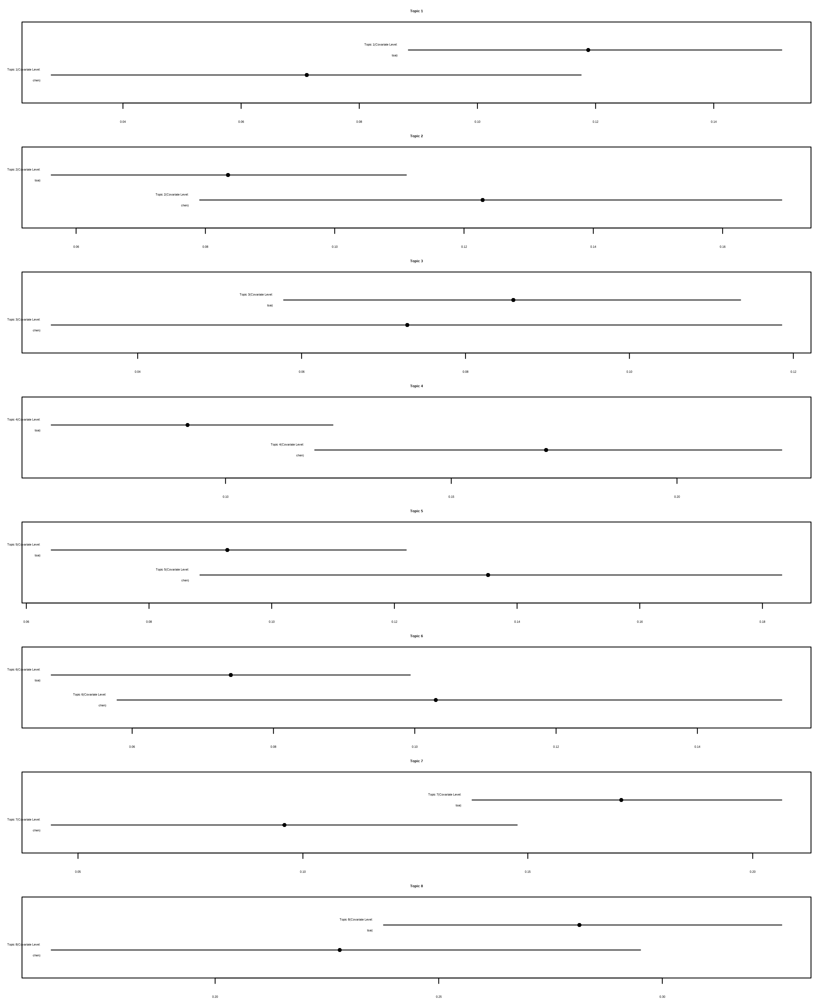

In [ ]:

options(repr.plot.width=10, repr.plot.height=12, repr.plot.res=300)

par(mfrow=c(8,1), mar=c(2,2,2,2))
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 1, main = "Topic 1")
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 2, main = "Topic 2")
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 3, main = "Topic 3")
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 4, main = "Topic 4")
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 5, main = "Topic 5")
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 6, main = "Topic 6")
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 7, main = "Topic 7")
plot(prep, "singer", model=selectedcontentmodel,
method="pointestimate", topics = 8, main = "Topic 8")


#ＢＴＭ

In [ ]:
install.packages("BTM")
library(BTM)

# BTM_tc


### BTM :tidy text 

In [ ]:

library(dplyr)
library(tidytext)
library(quanteda)
library(topicmodels)

corpus_unseg <- corpus(tcdf$text)
corpus_seg <- corpus_segment(corpus_unseg, pattern = " ")
#create DTM doc term matrix
q_dfm <- corpus_seg %>%
    tokenizers::tokenize_regex("\u3000") %>%
    tokens() %>%
    dfm() %>%
    dfm_select(pattern = "[\u4E00-\u9FFF]", valuetype = "regex") %>%
    dfm_trim(min_termfreq = 0)

tidy_text = tidy(q_dfm)
tidy_text$'document' = gsub("\\..*","",tidy_text$'document') 
tidy_text
corpus_dfm <- tidy_text %>% cast_dfm(document, term, count)

tidy(corpus_dfm) 
test = tidy(corpus_dfm)%>% select(document,term)
test

document,term,count
<chr>,<chr>,<dbl>
text1,黑,1
text1,黑,1
text6,黑,1
text6,黑,1
text16,黑,1
text37,黑,1
text38,黑,1
text71,黑,1
text76,黑,1


document,term,count
<chr>,<chr>,<dbl>
text1,黑,1
text6,黑,1
text16,黑,1
text37,黑,1
text38,黑,1
text71,黑,1
text76,黑,1
text78,黑,1
text138,黑,1


document,term
<chr>,<chr>
text1,黑
text6,黑
text16,黑
text37,黑
text38,黑
text71,黑
text76,黑
text78,黑
text138,黑


### BTM: detailed = False (not return voc and biterms)

In [ ]:
set.seed(321)
test = tidy(corpus_dfm)%>% select(document,term)
BTMmodel  <- BTM(test, k = 12, beta = 0.01, iter = 1000, trace = 100)
BTM_terms<- terms(BTMmodel, top_n = 10) #k =24 
BTM_terms

2022-06-11 07:13:42 Start Gibbs sampling iteration 1/1000
2022-06-11 07:13:52 Start Gibbs sampling iteration 101/1000
2022-06-11 07:14:02 Start Gibbs sampling iteration 201/1000
2022-06-11 07:14:11 Start Gibbs sampling iteration 301/1000
2022-06-11 07:14:21 Start Gibbs sampling iteration 401/1000
2022-06-11 07:14:32 Start Gibbs sampling iteration 501/1000
2022-06-11 07:14:42 Start Gibbs sampling iteration 601/1000
2022-06-11 07:14:52 Start Gibbs sampling iteration 701/1000
2022-06-11 07:15:01 Start Gibbs sampling iteration 801/1000
2022-06-11 07:15:11 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,你,0.04290
2,我,0.03841
3,一,0.03810
4,愛,0.03505
5,有,0.02717
6,個,0.02514
7,人,0.02338
8,想,0.02313
9,讓,0.02292


In [ ]:
BTMmodel$vocab

NULL

In [ ]:

set.seed(321)
BG_model <- BTM(test, k = 24, beta = 0.01, background = TRUE, iter = 1000, trace = 100)
BG_topicterms <- terms(BG_model, top_n = 10)
BG_topicterms

2022-06-11 07:15:21 Start Gibbs sampling iteration 1/1000
2022-06-11 07:15:40 Start Gibbs sampling iteration 101/1000
2022-06-11 07:15:58 Start Gibbs sampling iteration 201/1000
2022-06-11 07:16:16 Start Gibbs sampling iteration 301/1000
2022-06-11 07:16:34 Start Gibbs sampling iteration 401/1000
2022-06-11 07:16:52 Start Gibbs sampling iteration 501/1000
2022-06-11 07:17:10 Start Gibbs sampling iteration 601/1000
2022-06-11 07:17:28 Start Gibbs sampling iteration 701/1000
2022-06-11 07:17:47 Start Gibbs sampling iteration 801/1000
2022-06-11 07:18:05 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,二十,0.01111
2,似,0.01111
3,個,0.01111
4,冒險,0.01111
5,動,0.01111
6,地球,0.01111
7,壞,0.01111
8,學會,0.01111
9,害怕,0.01111


### BTM: detailed = True (return voc freq and biterms)
- k = 12 bg k =12 (or8

In [ ]:
set.seed(321)
test = tidy(corpus_dfm)%>% select(document,term)
k=12
BTMmodel  <- BTM(test, k = k, beta = 0.01, iter = 1000, trace = 100,detailed = T)
BTM_terms<- terms(BTMmodel, top_n = 10) #k =24 
BTM_terms

2022-06-11 07:35:40 Start Gibbs sampling iteration 1/1000
2022-06-11 07:35:50 Start Gibbs sampling iteration 101/1000
2022-06-11 07:36:00 Start Gibbs sampling iteration 201/1000
2022-06-11 07:36:09 Start Gibbs sampling iteration 301/1000
2022-06-11 07:36:19 Start Gibbs sampling iteration 401/1000
2022-06-11 07:36:29 Start Gibbs sampling iteration 501/1000
2022-06-11 07:36:39 Start Gibbs sampling iteration 601/1000
2022-06-11 07:36:49 Start Gibbs sampling iteration 701/1000
2022-06-11 07:36:59 Start Gibbs sampling iteration 801/1000
2022-06-11 07:37:08 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,你,0.04290
2,我,0.03841
3,一,0.03810
4,愛,0.03505
5,有,0.02717
6,個,0.02514
7,人,0.02338
8,想,0.02313
9,讓,0.02292


In [ ]:
BTMmodel$vocab #freq

token,freq
<chr>,<int>
一,302
一下,12
一世,1
一些,16
一些些,3
一件件,1
一切,50
一剎那,2
一半,3


In [ ]:
BTMmodel$biterms


term1,term2,topic
<chr>,<chr>,<int>
深邃,黑,1
野,黑,1
無畏,黑,1
星墜,黑,1
餘輝,黑,1
照亮,黑,1
誰,黑,1
流放,黑,1
者,黑,1


In [ ]:

set.seed(321)
k=12
BG_model <- BTM(test, k = k, beta = 0.01, background = TRUE, iter = 1000, trace = 100,detailed = T)
BG_topicterms <- terms(BG_model, top_n = 10)
BG_topicterms

2022-06-11 07:37:28 Start Gibbs sampling iteration 1/1000
2022-06-11 07:37:38 Start Gibbs sampling iteration 101/1000
2022-06-11 07:37:48 Start Gibbs sampling iteration 201/1000
2022-06-11 07:37:58 Start Gibbs sampling iteration 301/1000
2022-06-11 07:38:07 Start Gibbs sampling iteration 401/1000
2022-06-11 07:38:17 Start Gibbs sampling iteration 501/1000
2022-06-11 07:38:27 Start Gibbs sampling iteration 601/1000
2022-06-11 07:38:36 Start Gibbs sampling iteration 701/1000
2022-06-11 07:38:46 Start Gibbs sampling iteration 801/1000
2022-06-11 07:38:56 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,一點,0.01043
2,丟三忘四,0.01043
3,個,0.01043
4,們,0.01043
5,冒險,0.01043
6,動,0.01043
7,合理,0.01043
8,唱,0.01043
9,回頭,0.01043


### textplot_correlation_glasso: sparse term correlation glasso


In [ ]:
# install.packages('qgraph')
# install.packages('glasso')

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
test_dtf = document_term_frequencies(test, document = "document", term = "term")
test_dtf

doc_id,term,freq
<chr>,<chr>,<int>
text1,黑,1
text6,黑,1
text16,黑,1
text37,黑,1
text38,黑,1
text71,黑,1
text76,黑,1
text78,黑,1
text138,黑,1


In [ ]:
test_dtm = document_term_matrix(test_dtf)
test_dtm

   [[ suppressing 33 column names ‘一’, ‘一下’, ‘一世’ ... ]]



428 x 6087 sparse Matrix of class "dgCMatrix"
                                                                         
text1   1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text6   1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text16  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text37  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text38  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text71  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text76  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text78  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text138 1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text150 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . 1 .
text268 1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text276 1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . 

In [ ]:
test_dtm = dtm_remove_lowfreq(test_dtm, maxterms = 60) 
test_dtm

   [[ suppressing 60 column names ‘一’, ‘一切’, ‘一點’ ... ]]



427 x 60 sparse Matrix of class "dgCMatrix"
                                                                               
text1   1 . . . . . 1 1 1 . . 1 1 . . . . . . 1 . . 1 . . . . . . 1 . 1 . . . 1
text6   1 . . . . . . . . . . 1 . . . . . . . . . . . . . . 1 . 1 1 . 1 . . . .
text16  1 . 1 . . 1 1 1 1 . . 1 1 . . 1 . . . . . . . . . 1 1 . . 1 . . . . . 1
text37  1 . 1 . . 1 1 1 1 . . 1 1 . . 1 . . . . . . . . . 1 1 . . 1 . . . . . 1
text38  1 . . . . . . 1 . . 1 . . . . . . . . . . . . 1 . . . . . . . . . . . .
text71  1 . . . . . . . . . . 1 . . 1 . . . . . . . 1 . . . 1 1 . 1 1 . . 1 . .
text76  1 . 1 . . 1 1 1 1 . . 1 1 . . 1 . . . . . . . . . 1 1 . . 1 . . . . . 1
text78  1 . 1 1 . . 1 1 . . . 1 1 1 . . 1 . 1 . 1 . . . 1 1 1 1 . 1 . 1 . . . 1
text138 1 . . . 1 . . . 1 . . 1 . 1 1 . . . . . . . . 1 . . . . . 1 . . . . . .
text150 . . . . . . 1 . . . . 1 . . 1 . . . . . . . 1 . 1 . 1 . . 1 . . . . . .
text268 1 . . . 1 . . . . . . 1 . 1 1 . . . . . . . 1 1 . . . . . 1 . . . . 

In [ ]:
test_dtm_cor = dtm_cor(test_dtm)
test_dtm_cor

,一,一切,一點,上,下,世界,中,人,什麼,今天,⋯,自己,裡,說,誰,讓,走,這,那,開始,離開
一,1.000000,0.138254,0.066987,0.054695,0.129406,0.0107262,0.0583090,0.205258,-0.016765,0.066016,⋯,0.04875083,0.0325599,-0.034466,0.0220203,0.0139339,0.0794366,0.043752,0.150326,0.158001,0.063711
一切,0.138254,1.000000,0.009550,0.051571,0.042562,0.0039513,0.0772677,0.102109,0.051837,0.170158,⋯,0.05583814,-0.0759227,0.013610,0.0120627,0.0154201,0.0631718,0.090511,0.080183,0.007882,0.001928
一點,0.066987,0.009550,1.000000,0.100756,-0.017389,0.0907757,0.1027610,0.061726,0.039167,0.081374,⋯,0.04184094,0.1137139,0.061726,0.0397363,0.1119143,0.0040651,-0.017290,0.081220,0.105743,0.146006
上,0.054695,0.051571,0.100756,1.000000,0.080765,-0.0023000,0.0024144,0.045164,-0.051673,-0.016813,⋯,-0.05236593,0.1016715,-0.040330,-0.1040464,0.0915826,0.0597650,-0.043856,0.171722,0.033145,0.036428
下,0.129406,0.042562,-0.017389,0.080765,1.000000,0.0611964,0.1209770,-0.085857,-0.037953,0.003504,⋯,0.04573737,0.0102961,-0.114861,-0.0738778,0.0295168,0.0953091,0.048407,0.069881,0.081418,-0.045343
世界,0.010726,0.003951,0.090776,-0.002300,0.061196,1.0000000,0.0625711,0.054946,-0.025485,0.131734,⋯,0.13425634,0.0687310,-0.075580,0.0053744,0.0282273,0.0575490,0.074815,0.147785,-0.008859,0.061313
中,0.058309,0.077268,0.102761,0.002414,0.120977,0.0625711,1.0000000,-0.015758,-0.027464,0.013950,⋯,-0.03056591,0.0394676,0.030567,0.0080901,0.0412509,-0.0043820,0.014057,0.018145,0.193382,0.040209
人,0.205258,0.102109,0.061726,0.045164,-0.085857,0.0549463,-0.0157580,1.000000,0.066364,0.056541,⋯,0.09118901,-0.0323891,0.058794,0.0701993,0.2960404,0.0098635,0.139080,0.014924,0.047520,0.029257
什麼,-0.016765,0.051837,0.039167,-0.051673,-0.037953,-0.0254848,-0.0274637,0.066364,1.000000,0.078509,⋯,0.10074882,0.0480009,0.172417,0.0592671,0.0642910,0.0213787,0.070263,0.009768,0.102592,0.116788
今天,0.066016,0.170158,0.081374,-0.016813,0.003504,0.1317342,0.0139497,0.056541,0.078509,1.000000,⋯,0.13165534,0.0298475,0.146626,-0.0237905,-0.0139948,0.0299322,0.056951,0.173362,0.117499,-0.056556


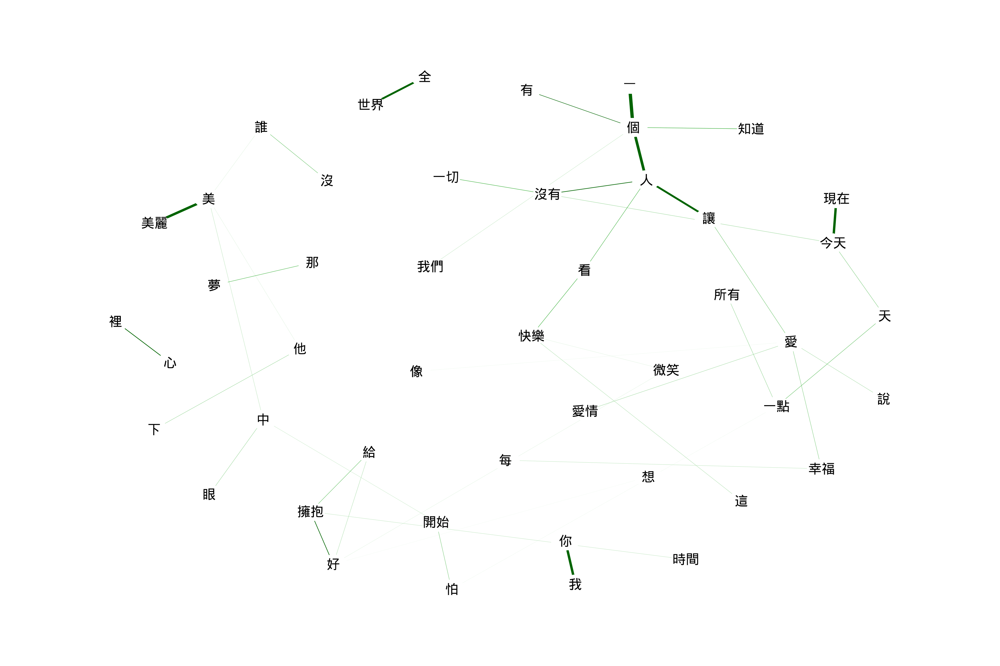

In [ ]:
#exclude zero-correlations from the graph
textplot_correlation_glasso(test_dtm_cor, exclude_zero = TRUE,label.cex = 3) 


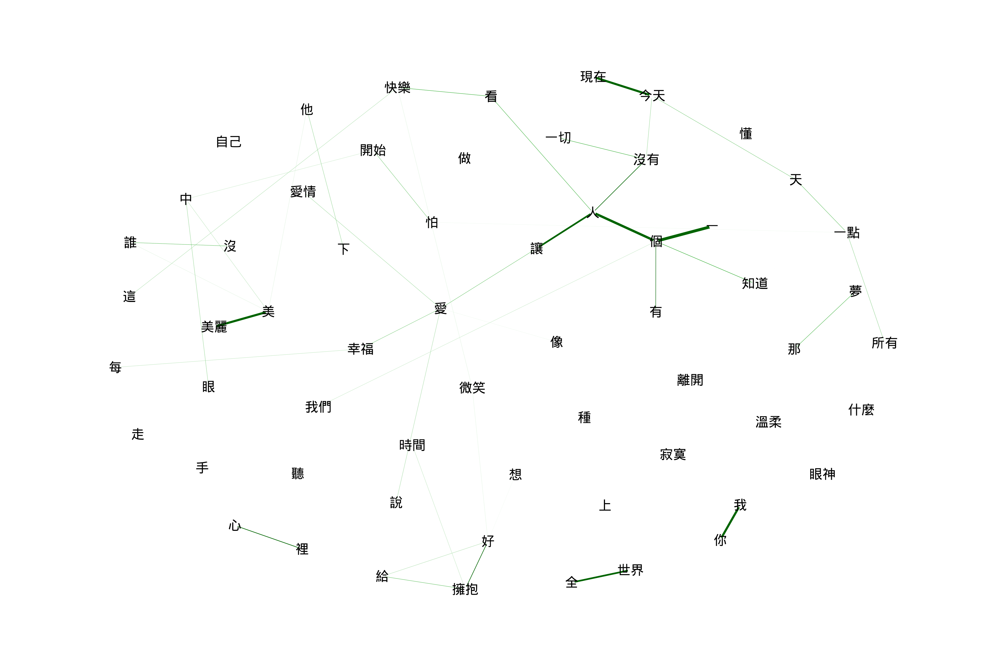

In [ ]:

textplot_correlation_glasso(test_dtm_cor, exclude_zero = FALSE,label.cex = 3)

# BTM_t


### BTM :tidy text 

In [ ]:

library(dplyr)
library(tidytext)
library(quanteda)
library(topicmodels)

corpus_unseg <- corpus(tsaidoc$text)
corpus_seg <- corpus_segment(corpus_unseg, pattern = " ")
#create DTM doc term matrix
q_dfm <- corpus_seg %>%
    tokenizers::tokenize_regex("\u3000") %>%
    tokens() %>%
    dfm() %>%
    dfm_select(pattern = "[\u4E00-\u9FFF]", valuetype = "regex") %>%
    dfm_trim(min_termfreq = 0)

tidy_text = tidy(q_dfm)
tidy_text$'document' = gsub("\\..*","",tidy_text$'document')   
tidy_text
corpus_dfm <- tidy_text %>% cast_dfm(document, term, count)

tidy(corpus_dfm) 
test = tidy(corpus_dfm)%>% select(document,term)
test

document,term,count
<chr>,<chr>,<dbl>
text1,黑,1
text1,黑,1
text6,黑,1
text6,黑,1
text16,黑,1
text37,黑,1
text38,黑,1
text71,黑,1
text76,黑,1


document,term,count
<chr>,<chr>,<dbl>
text1,黑,1
text6,黑,1
text16,黑,1
text37,黑,1
text38,黑,1
text71,黑,1
text76,黑,1
text78,黑,1
text138,黑,1


document,term
<chr>,<chr>
text1,黑
text6,黑
text16,黑
text37,黑
text38,黑
text71,黑
text76,黑
text78,黑
text138,黑


### BTM: detailed = False (not return voc and biterms)

In [ ]:

set.seed(321)
test = tidy(corpus_dfm)%>% select(document,term)
BTMmodel  <- BTM(test, k = 8, beta = 0.01, iter = 1000, trace = 100)
BTM_terms<- terms(BTMmodel, top_n = 10) #k =24 
BTM_terms

2022-06-11 07:43:19 Start Gibbs sampling iteration 1/1000
2022-06-11 07:43:25 Start Gibbs sampling iteration 101/1000
2022-06-11 07:43:31 Start Gibbs sampling iteration 201/1000
2022-06-11 07:43:37 Start Gibbs sampling iteration 301/1000
2022-06-11 07:43:43 Start Gibbs sampling iteration 401/1000
2022-06-11 07:43:48 Start Gibbs sampling iteration 501/1000
2022-06-11 07:43:55 Start Gibbs sampling iteration 601/1000
2022-06-11 07:44:01 Start Gibbs sampling iteration 701/1000
2022-06-11 07:44:07 Start Gibbs sampling iteration 801/1000
2022-06-11 07:44:12 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,你,0.03800
2,愛,0.03546
3,一,0.03488
4,我,0.03243
5,有,0.02568
6,想,0.02309
7,個,0.02287
8,說,0.02202
9,人,0.02179


In [ ]:
BTMmodel$vocab

NULL

In [ ]:

set.seed(321)
BG_model <- BTM(test, k = 8, beta = 0.01, background = TRUE, iter = 1000, trace = 100)
BG_topicterms <- terms(BG_model, top_n = 10)
BG_topicterms

2022-06-11 07:44:18 Start Gibbs sampling iteration 1/1000
2022-06-11 07:44:24 Start Gibbs sampling iteration 101/1000
2022-06-11 07:44:30 Start Gibbs sampling iteration 201/1000
2022-06-11 07:44:35 Start Gibbs sampling iteration 301/1000
2022-06-11 07:44:41 Start Gibbs sampling iteration 401/1000
2022-06-11 07:44:47 Start Gibbs sampling iteration 501/1000
2022-06-11 07:44:52 Start Gibbs sampling iteration 601/1000
2022-06-11 07:44:58 Start Gibbs sampling iteration 701/1000
2022-06-11 07:45:03 Start Gibbs sampling iteration 801/1000
2022-06-11 07:45:09 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,什麼,0.01447
2,今晚,0.01447
3,可,0.01447
4,告別,0.01447
5,單調,0.01447
6,微笑,0.01447
7,想,0.01447
8,愛情,0.01447
9,戴,0.01447


### BTM: detailed = True (return voc freq and biterms)

In [ ]:
set.seed(321)
test = tidy(corpus_dfm)%>% select(document,term)
k=8 
BTMmodel  <- BTM(test, k = k, beta = 0.01, iter = 1000, trace = 100,detailed = T)
BTM_terms<- terms(BTMmodel, top_n = 10)  
BTM_terms

2022-06-11 07:45:15 Start Gibbs sampling iteration 1/1000
2022-06-11 07:45:21 Start Gibbs sampling iteration 101/1000
2022-06-11 07:45:26 Start Gibbs sampling iteration 201/1000
2022-06-11 07:45:32 Start Gibbs sampling iteration 301/1000
2022-06-11 07:45:38 Start Gibbs sampling iteration 401/1000
2022-06-11 07:45:43 Start Gibbs sampling iteration 501/1000
2022-06-11 07:45:49 Start Gibbs sampling iteration 601/1000
2022-06-11 07:45:55 Start Gibbs sampling iteration 701/1000
2022-06-11 07:46:00 Start Gibbs sampling iteration 801/1000
2022-06-11 07:46:06 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,你,0.03800
2,愛,0.03546
3,一,0.03488
4,我,0.03243
5,有,0.02568
6,想,0.02309
7,個,0.02287
8,說,0.02202
9,人,0.02179


In [ ]:
BTMmodel$vocab #freq

token,freq
<chr>,<int>
一,218
一下,10
一世,1
一些,12
一些些,1
一切,42
一剎那,2
一半,2
一成不變,1


In [ ]:

BTMmodel$biterms


term1,term2,topic
<chr>,<chr>,<int>
深邃,黑,1
野,黑,1
無畏,黑,1
星墜,黑,1
餘輝,黑,1
照亮,黑,1
誰,黑,1
流放,黑,1
者,黑,1


In [ ]:

set.seed(321)
bg_k = 8  
BG_model <- BTM(test, k = bg_k, beta = 0.01, background = TRUE, iter = 1000, trace = 100,detailed = T)
BG_topicterms <- terms(BG_model, top_n = 10)
BG_topicterms

2022-06-11 07:46:20 Start Gibbs sampling iteration 1/1000
2022-06-11 07:46:26 Start Gibbs sampling iteration 101/1000
2022-06-11 07:46:32 Start Gibbs sampling iteration 201/1000
2022-06-11 07:46:37 Start Gibbs sampling iteration 301/1000
2022-06-11 07:46:43 Start Gibbs sampling iteration 401/1000
2022-06-11 07:46:49 Start Gibbs sampling iteration 501/1000
2022-06-11 07:46:54 Start Gibbs sampling iteration 601/1000
2022-06-11 07:47:00 Start Gibbs sampling iteration 701/1000
2022-06-11 07:47:06 Start Gibbs sampling iteration 801/1000
2022-06-11 07:47:13 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,什麼,0.01447
2,今晚,0.01447
3,可,0.01447
4,告別,0.01447
5,單調,0.01447
6,微笑,0.01447
7,想,0.01447
8,愛情,0.01447
9,戴,0.01447


### textplot_correlation_glasso


In [ ]:
test_dtf = document_term_frequencies(test, document = "document", term = "term")
test_dtf

doc_id,term,freq
<chr>,<chr>,<int>
text1,黑,1
text6,黑,1
text16,黑,1
text37,黑,1
text38,黑,1
text71,黑,1
text76,黑,1
text78,黑,1
text138,黑,1


In [ ]:
test_dtm = document_term_matrix(test_dtf)
test_dtm

   [[ suppressing 33 column names ‘一’, ‘一下’, ‘一世’ ... ]]



306 x 5182 sparse Matrix of class "dgCMatrix"
                                                                         
text1   1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text6   1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text16  1 . . . . . . . . . . . . . . . . . . . . . . . . 1 . . . . . . 1
text37  1 . . . . . . . . . . . . . . . . . . . . . . . . 1 . . . . . . 1
text38  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text71  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text76  1 . . . . . . . . . . . . . . . . . . . . . . . . 1 . . . . . . 1
text78  1 . . . . . . . . . . . . . . . . . . . . . . . . 1 . . . . . . .
text138 1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text150 . . . . . . . . . . . . . . . . . . . . . . . 1 . . . . . . . . .
text268 1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text276 1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . 

In [ ]:
test_dtm = dtm_remove_lowfreq(test_dtm, maxterms = 60) #remove low term
test_dtm

   [[ suppressing 60 column names ‘一’, ‘一切’, ‘一點’ ... ]]



305 x 60 sparse Matrix of class "dgCMatrix"
                                                                               
text1   1 . . . . 1 1 1 . . 1 1 . . . . . . 1 . . 1 . . . . . . 1 . 1 . . . 1 .
text6   1 . . . . . . . . . 1 . . . . . . . . . . . . . . 1 . 1 1 . 1 . . . . .
text16  1 . 1 . 1 1 1 1 . . 1 1 . . 1 1 . . . . . . . . 1 1 . . 1 . . . . . 1 .
text37  1 . 1 . 1 1 1 1 . . 1 1 . . 1 1 . . . . . . . . 1 1 . . 1 . . . . . 1 .
text38  1 . . . . . 1 . . 1 . . . . . . . . . . . . 1 . . . . . . . . . . . . .
text71  1 . . . . . . . . . 1 . . 1 . . . . . . . 1 . . . 1 1 . 1 1 . . 1 . . .
text76  1 . 1 . 1 1 1 1 . . 1 1 . . 1 1 . . . . . . . . 1 1 . . 1 . . . . . 1 .
text78  1 . 1 1 . 1 1 . . . 1 1 1 . . . . 1 . 1 . . . 1 1 1 1 . 1 . 1 . . . 1 .
text138 1 . . . . . . 1 . . 1 . 1 1 . . . . . . . . 1 . . . . . 1 . . . . . . .
text150 . . . . . 1 . . . . 1 . . 1 . . . . . . . 1 . 1 . 1 . . 1 . . . . . . .
text268 1 . . . . . . . . . 1 . 1 1 . . . . . . . 1 1 . . . . . 1 . . . . . 

In [ ]:
test_dtm_cor = dtm_cor(test_dtm)
test_dtm_cor

,一,一切,一點,上,世界,中,人,什麼,今天,他,⋯,自己,裡,說,誰,變,讓,走,這,那,開始
一,1.000000,0.1260185,0.0836216,0.060707,0.02470915,0.037032,0.169842,0.0510500,0.0461970,0.0106543,⋯,0.098763,0.005998,-0.044670,0.0966960,0.099945,-0.038378,0.119492,0.05632356071718679080,0.124591,0.182986
一切,0.126019,1.0000000,-0.0088914,0.052497,-0.03896391,0.109707,0.111934,0.0828570,0.1319043,-0.0005852,⋯,0.048326,-0.086450,0.013773,0.0065680,0.065664,0.001310,0.102038,0.04272819436577480340,0.039409,0.010548
一點,0.083622,-0.0088914,1.0000000,0.103487,0.08204494,0.086191,0.037454,-0.0044890,0.0581073,0.1548725,⋯,0.042409,0.168100,-0.038880,-0.0233935,0.183076,0.074675,0.057172,-0.08228454229793522035,0.089645,0.088287
上,0.060707,0.0524974,0.1034866,1.000000,0.01734410,0.009724,0.101715,-0.0597561,-0.0324531,0.0331065,⋯,-0.040196,0.073510,-0.104037,-0.1136949,-0.065645,0.060448,0.061429,-0.01373476072383889371,0.177164,0.037657
世界,0.024709,-0.0389639,0.0820449,0.017344,1.00000000,0.125101,-0.002830,-0.0633460,0.1528118,0.0121001,⋯,0.127946,0.093059,-0.153177,-0.0762307,0.073470,-0.070812,0.047492,0.08329350221499001727,0.142699,-0.009632
中,0.037032,0.1097067,0.0861910,0.009724,0.12510138,1.000000,-0.024398,0.0395660,0.0576906,0.0805714,⋯,-0.003621,0.083749,0.051583,0.0391678,0.069495,0.041335,-0.019767,-0.04526124861601107247,0.026746,0.224888
人,0.169842,0.1119336,0.0374543,0.101715,-0.00283021,-0.024398,1.000000,0.0608962,0.0833141,0.0839274,⋯,0.101439,-0.038993,0.055442,0.0653419,0.063973,0.312413,0.046255,0.09944081034645074757,-0.006771,0.016000
什麼,0.051050,0.0828570,-0.0044890,-0.059756,-0.06334598,0.039566,0.060896,1.0000000,0.0809794,0.0687499,⋯,0.057700,0.040042,0.131395,0.1041858,0.089482,0.053939,0.021963,0.06970849271427537186,0.030078,0.162077
今天,0.046197,0.1319043,0.0581073,-0.032453,0.15281178,0.057691,0.083314,0.0809794,1.0000000,-0.0400261,⋯,0.154791,0.057600,0.120153,-0.0295442,0.108148,0.011074,0.089861,0.04809860702438820135,0.144785,0.152387
他,0.010654,-0.0005852,0.1548725,0.033106,0.01210009,0.080571,0.083927,0.0687499,-0.0400261,1.0000000,⋯,0.126659,0.112519,0.169090,-0.0221403,-0.073557,0.062972,-0.037771,0.02869540875217281226,0.203815,0.178330


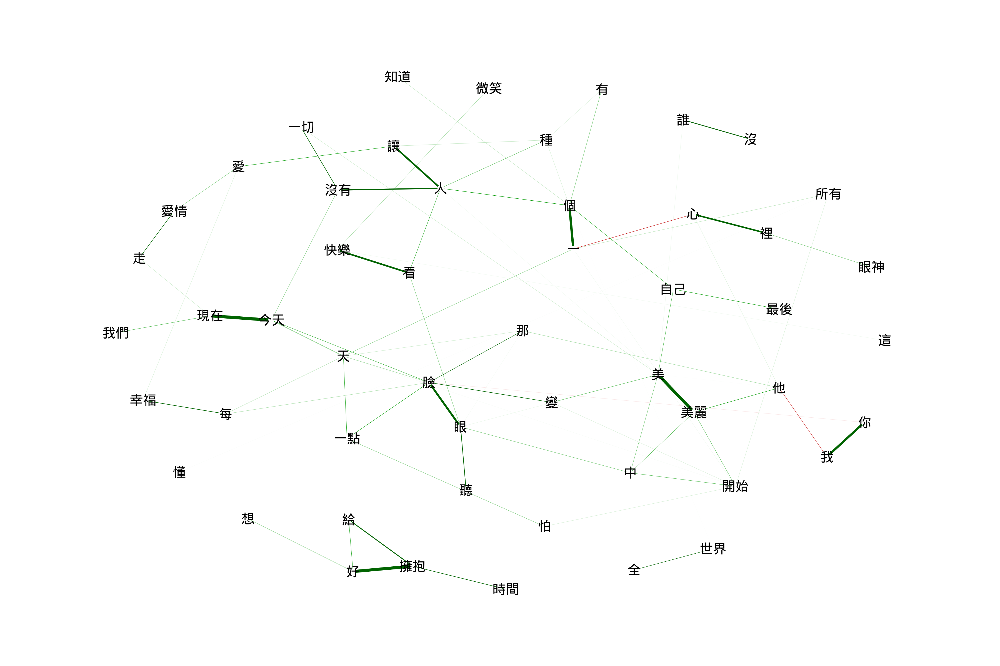

In [ ]:
#exclude zero-correlations from the graph
textplot_correlation_glasso(test_dtm_cor, exclude_zero = TRUE,label.cex = 3) 

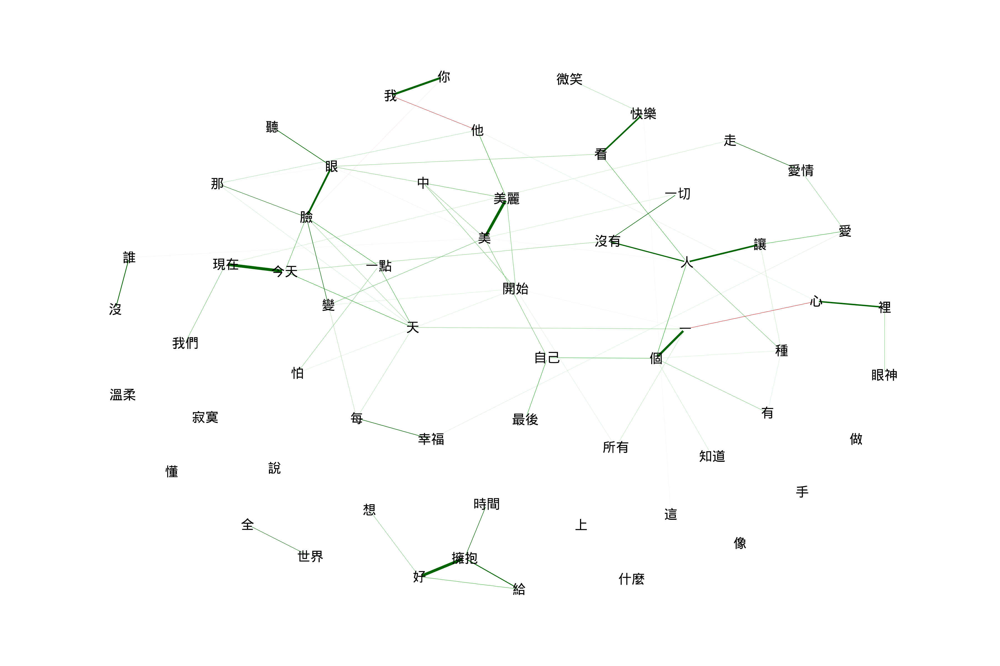

In [ ]:
textplot_correlation_glasso(test_dtm_cor, exclude_zero = FALSE,label.cex = 3)

# BTM_c


### BTM :tidy text 

In [ ]:
library(dplyr)
library(tidytext)
library(quanteda)
library(topicmodels)

corpus_unseg <- corpus(chendoc$text)
corpus_seg <- corpus_segment(corpus_unseg, pattern = " ")
#create DTM doc term matrix
q_dfm <- corpus_seg %>%
    tokenizers::tokenize_regex("\u3000") %>%
    tokens() %>%
    dfm() %>%
    dfm_select(pattern = "[\u4E00-\u9FFF]", valuetype = "regex") %>%
    dfm_trim(min_termfreq = 0)

tidy_text = tidy(q_dfm)
tidy_text$'document' = gsub("\\..*","",tidy_text$'document') #用這樣gsub無法tidy(q_dfm)['document']
tidy_text
corpus_dfm <- tidy_text %>% cast_dfm(document, term, count)


test = tidy(corpus_dfm)%>% select(document,term)
test

document,term,count
<chr>,<chr>,<dbl>
text1,頁,1
text1,白紙,1
text1,描繪,1
text71,描繪,1
text1,我,1
text1,我,1
text1,我,1
text1,我,1
text1,我,1


document,term,count
<chr>,<chr>,<dbl>
text1,頁,1
text1,白紙,1
text1,描繪,1
text71,描繪,1
text1,我,1
text71,我,1
text2,我,1
text3,我,1
text4,我,1


document,term
<chr>,<chr>
text1,頁
text1,白紙
text1,描繪
text71,描繪
text1,我
text71,我
text2,我
text3,我
text4,我


### BTM: detailed = False (not return voc and biterms)

In [ ]:

set.seed(321)
test = tidy(corpus_dfm)%>% select(document,term)
BTMmodel  <- BTM(test, k = 12, beta = 0.01, iter = 1000, trace = 100)
BTM_terms<- terms(BTMmodel, top_n = 10) #k =24 
BTM_terms

2022-06-11 07:49:30 Start Gibbs sampling iteration 1/1000
2022-06-11 07:49:32 Start Gibbs sampling iteration 101/1000
2022-06-11 07:49:34 Start Gibbs sampling iteration 201/1000
2022-06-11 07:49:36 Start Gibbs sampling iteration 301/1000
2022-06-11 07:49:38 Start Gibbs sampling iteration 401/1000
2022-06-11 07:49:40 Start Gibbs sampling iteration 501/1000
2022-06-11 07:49:42 Start Gibbs sampling iteration 601/1000
2022-06-11 07:49:44 Start Gibbs sampling iteration 701/1000
2022-06-11 07:49:46 Start Gibbs sampling iteration 801/1000
2022-06-11 07:49:48 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,天,0.01222
2,靜靜,0.01222
3,躺,0.01200
4,感受,0.01189
5,熱,0.01135
6,走過,0.01135
7,身體,0.01135
8,好幾,0.01071
9,街,0.01071


### BTM: detailed = True (return voc freq and biterms) 


In [ ]:
set.seed(321)
test = tidy(corpus_dfm)%>% select(document,term)
k=12
BTMmodel  <- BTM(test, k = k, beta = 0.01, iter = 1000, trace = 100,detailed = T)
BTM_terms<- terms(BTMmodel, top_n = 10)  
BTM_terms

2022-06-11 07:49:50 Start Gibbs sampling iteration 1/1000
2022-06-11 07:49:52 Start Gibbs sampling iteration 101/1000
2022-06-11 07:49:54 Start Gibbs sampling iteration 201/1000
2022-06-11 07:49:56 Start Gibbs sampling iteration 301/1000
2022-06-11 07:49:58 Start Gibbs sampling iteration 401/1000
2022-06-11 07:50:00 Start Gibbs sampling iteration 501/1000
2022-06-11 07:50:02 Start Gibbs sampling iteration 601/1000
2022-06-11 07:50:04 Start Gibbs sampling iteration 701/1000
2022-06-11 07:50:06 Start Gibbs sampling iteration 801/1000
2022-06-11 07:50:08 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,天,0.01222
2,靜靜,0.01222
3,躺,0.01200
4,感受,0.01189
5,熱,0.01135
6,走過,0.01135
7,身體,0.01135
8,好幾,0.01071
9,街,0.01071


In [ ]:
BTMmodel$vocab #freq

token,freq
<chr>,<int>
一,84
一下,2
一些,4
一些些,2
一件件,1
一切,8
一半,1
一如,2
一朵朵,1


In [ ]:
BTMmodel$biterms


term1,term2,topic
<chr>,<chr>,<int>
白紙,頁,3
描繪,頁,3
我,頁,3
這,頁,3
滿,頁,3
身,頁,3
創傷,頁,3
美麗,頁,3
模樣,頁,3


In [ ]:

set.seed(321)
bg_k =  8
BG_model <- BTM(test, k = bg_k, beta = 0.01, background = TRUE, iter = 1000, trace = 100,detailed = T)
BG_topicterms <- terms(BG_model, top_n = 10)
BG_topicterms

2022-06-11 07:50:18 Start Gibbs sampling iteration 1/1000
2022-06-11 07:50:20 Start Gibbs sampling iteration 101/1000
2022-06-11 07:50:21 Start Gibbs sampling iteration 201/1000
2022-06-11 07:50:23 Start Gibbs sampling iteration 301/1000
2022-06-11 07:50:24 Start Gibbs sampling iteration 401/1000
2022-06-11 07:50:25 Start Gibbs sampling iteration 501/1000
2022-06-11 07:50:27 Start Gibbs sampling iteration 601/1000
2022-06-11 07:50:30 Start Gibbs sampling iteration 701/1000
2022-06-11 07:50:31 Start Gibbs sampling iteration 801/1000
2022-06-11 07:50:33 Start Gibbs sampling iteration 901/1000


,token,probability
,<chr>,<dbl>
1,之間,0.01427
2,以後,0.01427
3,你,0.01427
4,個,0.01427
5,原諒,0.01427
6,命令,0.01427
7,喜歡,0.01427
8,喝,0.01427
9,地,0.01427


### textplot_correlation_glasso:

In [ ]:
test_dtf = document_term_frequencies(test, document = "document", term = "term")
test_dtf

doc_id,term,freq
<chr>,<chr>,<int>
text1,頁,1
text1,白紙,1
text1,描繪,1
text71,描繪,1
text1,我,1
text71,我,1
text2,我,1
text3,我,1
text4,我,1


In [ ]:
test_dtm = document_term_matrix(test_dtf)
test_dtm

   [[ suppressing 33 column names ‘一’, ‘一下’, ‘一些’ ... ]]



122 x 2280 sparse Matrix of class "dgCMatrix"
                                                                         
text1   1 . . . . 1 1 . . 1 . 1 . . . . . . . . . . . . 1 . . . . . . . .
text71  1 . . . 1 . . . . . . . . . . . 1 . . . . . . . . . . . . . . . .
text2   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text3   1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text4   1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text5   1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text6   1 . . . . . . . . . . . . . . . . . . . . . . . 1 . . . . 1 . . .
text8   1 . . 1 . . . . . . . . . . . . . . 1 . . . . . . . . 1 . . . . .
text9   1 . . . . . . . . . . . . . . 1 . . . . 1 1 1 . 1 1 . . . . . . .
text10  1 . . . . . . . . . 1 . 1 . . . . . . . . . . . 1 . . . . 1 . . .
text11  1 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
text12  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . 

In [ ]:
test_dtm = dtm_remove_lowfreq(test_dtm, maxterms = 60) 
test_dtm

   [[ suppressing 60 column names ‘一’, ‘上’, ‘下’ ... ]]



122 x 60 sparse Matrix of class "dgCMatrix"
                                                                               
text1   1 1 . . . . . . 1 1 . . . . . . . . . 1 . . 1 . 1 . . 1 1 1 . 1 . . 1 1
text71  1 . . . 1 . . . 1 1 1 . . . . . . . . . . . . . . . . 1 . . 1 . 1 1 . .
text2   . . . . . . . . 1 . . . . . . . . . . . . . . 1 . . . 1 . . . . . . . .
text3   1 . . . . . 1 . 1 1 . . . . . . . . . . . . . 1 1 . . 1 1 . . . . . . .
text4   1 . . . . 1 . . 1 1 . . . . . . . 1 1 . . . 1 . . . . 1 . . . . . . . 1
text5   1 . . . . 1 . . 1 1 . . . . . . . . . . . 1 . . 1 . . 1 1 . . . . . . 1
text6   1 1 . . . 1 . . 1 1 1 . . . . . . . . . 1 . . . . . . 1 1 . . . . . 1 .
text8   1 . . 1 . 1 . . 1 1 1 . 1 . 1 . . . . . . . . 1 1 . 1 1 . . . . 1 . . 1
text9   1 1 . 1 . . 1 . 1 1 . 1 . . . . 1 . . 1 . . . . 1 . . 1 1 . . . . . . 1
text10  1 1 . . . . . . 1 1 . . . . . . . . . . . . . 1 1 . . 1 1 . . . . . . 1
text11  1 . . . . . . . 1 . . . . . . . . . . . . 1 . . . . . 1 . . . . . . 

In [ ]:
test_dtm_cor = dtm_cor(test_dtm)
test_dtm_cor

,一,上,下,世界,中,人,什麼,他,你,個,⋯,說,誰,讓,走,這,這樣,邊,那,離開,需要
一,1.0000000,0.039246,0.144029,-0.037834,0.110219,0.291167,-0.172326,0.117550,0.0008596,0.380546,⋯,-0.020397,-0.211859,0.14160,-0.006793,-0.001319,-0.091038,0.043845,0.229907,0.055253,0.002821
上,0.0392456,1.000000,0.019158,-0.062551,-0.017584,-0.108028,-0.031174,0.114408,-0.0704068,0.216043,⋯,0.126570,-0.087909,0.17056,0.057273,-0.134279,-0.101983,0.059855,0.165567,0.128239,-0.161983
下,0.1440286,0.019158,1.000000,-0.052833,0.191464,0.050677,-0.138424,0.194288,-0.0763695,0.144774,⋯,-0.155158,-0.194852,0.02496,0.019158,0.117211,-0.056490,-0.039848,-0.085383,-0.039911,0.113390
世界,-0.0378344,-0.062551,-0.052833,1.000000,-0.133092,0.189462,0.092301,-0.098539,-0.0610642,0.109672,⋯,0.109775,0.209733,0.31435,0.100975,-0.001562,0.418220,-0.088828,0.094934,0.211417,0.037300
中,0.1102191,-0.017584,0.191464,-0.133092,1.000000,-0.002862,-0.191929,0.230062,0.0700965,0.090726,⋯,-0.038164,-0.106483,0.04124,0.036048,0.173669,-0.113480,-0.024972,-0.031454,-0.043174,0.163235
人,0.2911672,-0.108028,0.050677,0.189462,-0.002862,1.000000,0.096850,0.204213,-0.0834292,0.536197,⋯,0.020603,0.011115,0.26029,-0.062893,0.206942,0.070509,-0.001910,-0.002406,-0.003303,0.091735
什麼,-0.1723260,-0.031174,-0.138424,0.092301,-0.191929,0.096850,1.000000,-0.112267,0.2035048,-0.042201,⋯,0.298899,-0.038547,0.08916,0.015207,0.093036,0.210029,0.021595,-0.023079,0.244381,-0.170059
他,0.1175503,0.114408,0.194288,-0.098539,0.230062,0.204213,-0.112267,1.000000,0.0554754,0.090322,⋯,0.098336,0.079760,0.13283,-0.161983,0.096033,-0.124340,0.153549,0.006140,-0.012136,-0.119266
你,0.0008596,-0.070407,-0.076370,-0.061064,0.070097,-0.083429,0.203505,0.055475,1.0000000,-0.169975,⋯,0.064446,-0.034994,0.19426,-0.070407,0.176464,0.063696,0.046784,0.024694,-0.003698,-0.023222
個,0.3805459,0.216043,0.144774,0.109672,0.090726,0.536197,-0.042201,0.090322,-0.1699750,1.000000,⋯,-0.013969,-0.230184,0.20000,0.042640,0.109319,0.013716,0.060553,0.264253,0.027283,0.036306


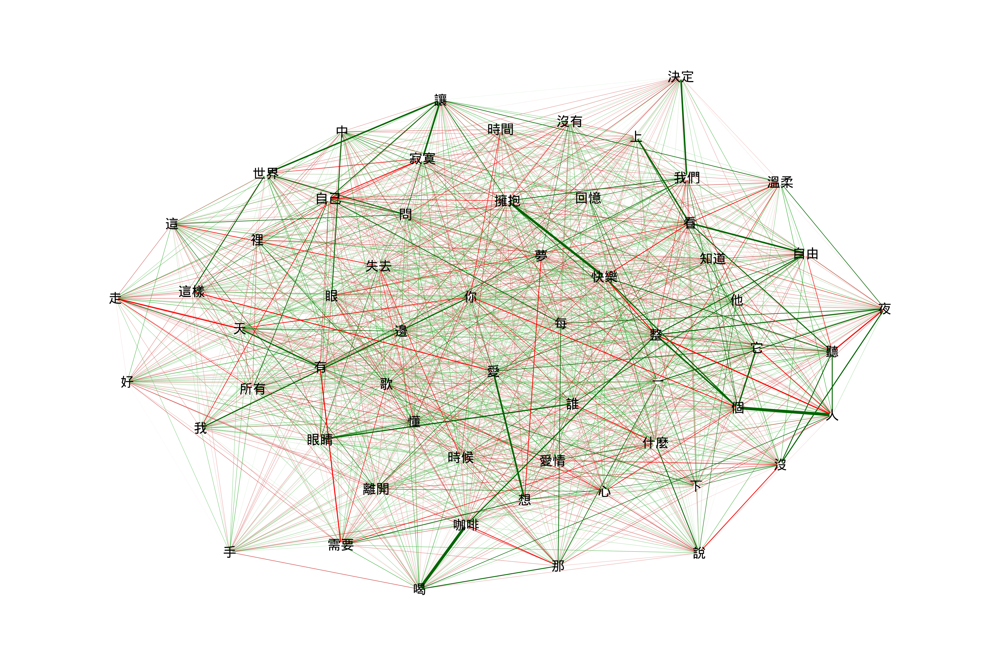

In [ ]:
#exclude zero-correlations from the graph
textplot_correlation_glasso(test_dtm_cor, exclude_zero = TRUE,label.cex = 3) 


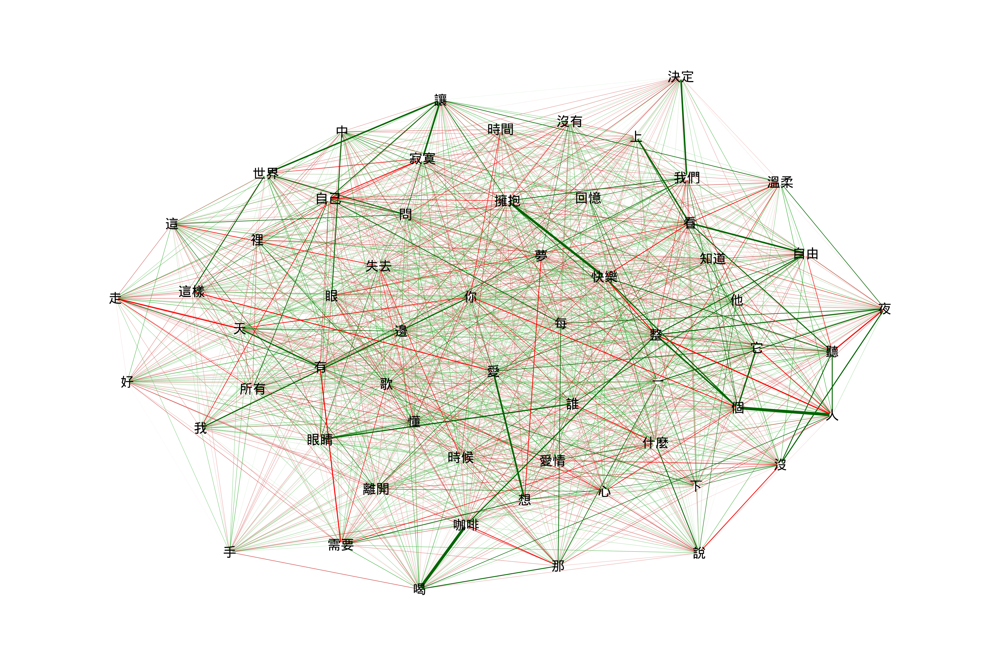

In [ ]:
textplot_correlation_glasso(test_dtm_cor, exclude_zero = FALSE,label.cex = 3)